# Apple Scab Detection Using Deep Learning Based CNN

## DSE309 Advanced Programming in Python - Project, Submitted by Ayush Dabra (19069), Department of Data Science and Engineering

## AppleScabFDs Dataset 

### Context

Dataset contains images with apples infected by scab. The images are grouped in two folders: "Healthy" and "Scab". The collection of digital images were carried out in different locations of Latvia. Digital images with characteristic scab symptoms on fruits were collected by the Institute of Horticulture (LatHort) under project "lzp-2019/1-0094 Application of deep learning and datamining for the study of plant-pathogen interaction: the case of apple and pear scab" with a goal to create mobile application for apple scab detection using convolution neural networks.

### Technical Information

Devices: smartphone cameras (12 MP, 13 MP, 48 MP) and a digital compact camera (10 MP). The collection of images was carried out in field conditions, in orchards. The images were taken at three different stages of the day - in the morning (9:00 - 10:00), around noon (12:00 - 14:00), as well as in the evening (16:00 - 17:00) to provide a variety of natural light conditions. The images were also taken on both sunny days and overcast days to provide different types of light (soft light and hard light). The leaves were framed so that they occupied the image area as much as possible and were in the center of the image, and the focal point was on the object. The object may have had other leaves or fruits in the background. The same object was photographed from multiple viewpoints.

### Citation

S. Kodors, G. Lacis, O. Sokolova, V. Zhukovs, I. Apeinans and T. Bartulsons. 2021. Apple Scab Detection using CNN and Transfer Learning. *Agronomy Research*, 19(2), 507–519. doi: [10.15159/AR.21.045](https://doi.org/10.15159/ar.21.045)


# Installing and Importing Libraries

### Libraries Used:

1. **NumPy -** For general array programming.
2. **Pandas -** For creating dataframe and storing the confusion matrix.
3. **Matplotlib -** Extensively used for data visualization.
4. **OpenCV -** For Computer Vision tools. Extensively used for reading, resizing, color space conversion, etc.
5. **Albumentations -** For train data augmentation (used in the data preparation notebook).
6. **Scikit-learn -** For computing the class weights, confusion matrix and classification report.
7. **PIL (Python Imaging Library aka Pillow) -** ImageFont is used for stroing the bitmap font, that is used in the model architecture visualization.
8. **TensorFlow -** For the deep learning CNN model.
9. **Keras -** For the deep learning CNN model.
10. **Visualkeras -** For visualization of deep learning model architecture.
11. **Keract -** For visualizing the activations (outputs) and gradients of each layer of the model.
12. Miscellaneous libraries like os, random, sys, etc. are also used in this project.

In [1]:
!pip install keract
!pip install visualkeras

import keract
import visualkeras

     |████████████████████████████████| 795 kB 690 kB/s eta 0:00:01


In [2]:
import numpy as np
import pandas as pd
from IPython.display import SVG
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from PIL import Image, ImageFont
import os, re, sys, random, shutil, cv2
from sklearn.utils import class_weight
from sklearn.metrics import classification_report, confusion_matrix

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import backend as K
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import applications, optimizers
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.utils import model_to_dot, plot_model, to_categorical
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, CSVLogger, LearningRateScheduler
from tensorflow.keras.layers import Dense, Flatten, Add, Dropout, GlobalAveragePooling2D

# Importing Augmented Dataset

In [3]:
data_dir = '../input/applescabfds/AppleScabFDs/'
train_data_dir = '../input/applescabfds-dataset/Augmented_AppleScabFDs/train/'
test_data_dir = '../input/applescabfds-dataset/Augmented_AppleScabFDs/test/'

# Exploratory Data Analysis

## Original AppleScabFDs Dataset

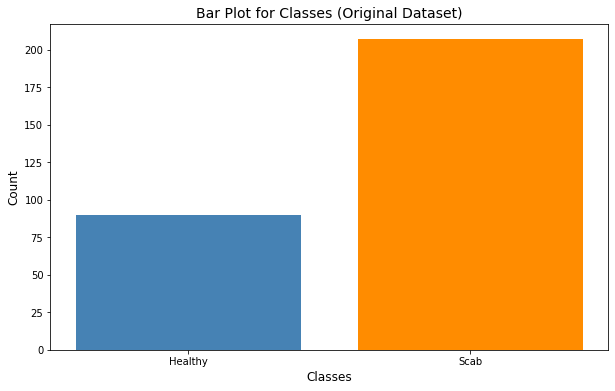

In [4]:
num_healthy_images = len(os.listdir(data_dir+'Healthy'))
num_scab_images = len(os.listdir(data_dir+'Scab'))
plt.figure(figsize=(10, 6))
data = {'Healthy': num_healthy_images, 'Scab':num_scab_images}
plt.bar(data.keys(), data.values(), color = ['steelblue', 'darkorange'])
plt.title('Bar Plot for Classes (Original Dataset)', fontsize=14)
plt.xlabel("Classes", fontsize=12) 
plt.ylabel("Count", fontsize=12) 

plt.savefig('data_bar_plot', facecolor= 'w', transparent= False, bbox_inches= 'tight', dpi= 300)

In [5]:
print('Original Dataset\n')
print('Healthy:', num_healthy_images)
print('Scab:', num_scab_images)

Original Dataset

Healthy: 90
Scab: 207


## Augmented AppleScabFDs Dataset

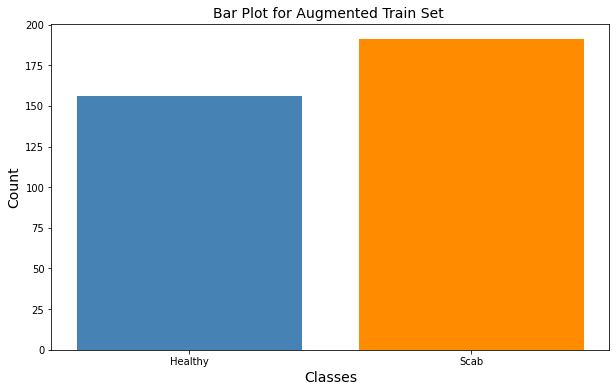

In [6]:
# Training set

plt.figure(figsize=(10, 6))
data = {'Healthy': len(os.listdir(train_data_dir+'Healthy')), 'Scab': len(os.listdir(train_data_dir+'Scab'))}
plt.bar(data.keys(), data.values(), color = ['steelblue', 'darkorange'])
plt.title('Bar Plot for Augmented Train Set ', fontsize=14)
plt.xlabel("Classes", fontsize=14) 
plt.ylabel("Count", fontsize=14) 

plt.savefig('aug_train_set_plot', facecolor= 'w', transparent= False, bbox_inches= 'tight', dpi= 300)

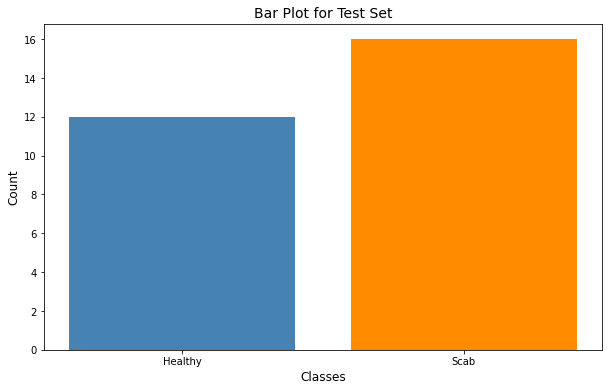

In [7]:
# Test set

plt.figure(figsize=(10, 6))
data = {'Healthy': len(os.listdir(test_data_dir+'Healthy')), 'Scab': len(os.listdir(test_data_dir+'Scab'))}
plt.bar(data.keys(), data.values(), color = ['steelblue', 'darkorange'])
plt.title('Bar Plot for Test Set', fontsize=14)
plt.xlabel("Classes", fontsize=12) 
plt.ylabel("Count", fontsize=12) 

plt.savefig('test_set_plot', facecolor= 'w', transparent= False, bbox_inches= 'tight', dpi= 300)

In [8]:
print('Training Set (Augmented Dataset):')
print('Healthy (Augmented Class):', len(os.listdir(train_data_dir+'Healthy')))
print('Scab:', len(os.listdir(train_data_dir+'Scab')))

print('\nTesting Set:')
print('Healthy:', len(os.listdir(test_data_dir+'Healthy')))
print('Scab:', len(os.listdir(test_data_dir+'Scab')))

Training Set (Augmented Dataset):
Healthy (Augmented Class): 156
Scab: 191

Testing Set:
Healthy: 12
Scab: 16


## Data Visualization

In [9]:
def show_data(path, label):
    fig, axs = plt.subplots(3, 4, figsize=(16, 12), constrained_layout=True)
    if label == 'healthy':
        files = os.listdir(f'{path}Healthy/')
        files.sort()
        aug_files = files[4:82]
        files = list(set(files) - set(aug_files)) + list(set(aug_files) - set(files))
        files.sort()

        fig.suptitle('Healthy Apples in Train Set\n', fontsize=18, fontweight='medium')
        idx = 32
        for i in range(3):
            for j in range(4):
                if j % 2 == 0:
                    axs[i][j].imshow(cv2.resize(cv2.cvtColor(cv2.imread(f'{path}Healthy/{files[idx]}'), cv2.COLOR_BGR2RGB),(500, 500)))
                    axs[i][j].set_title(f'{files[idx]}', fontdict = {'fontsize':14, 'fontweight':'medium'})
                    axs[i][j].set_xticks(np.arange(0, 501, 100))
                    axs[i][j].set_yticks(np.arange(0, 501, 100))
                    axs[i][j].grid(False)
                    axs[i][j].axis(True)
                elif j % 2 != 0:
                    axs[i][j].imshow(cv2.resize(cv2.cvtColor(cv2.imread(f'{path}Healthy/{aug_files[idx]}'), cv2.COLOR_BGR2RGB),(500, 500)))
                    axs[i][j].set_title(f'{aug_files[idx]}', fontdict = {'fontsize':14, 'fontweight':'medium'})
                    axs[i][j].set_xticks(np.arange(0, 501, 100))
                    axs[i][j].set_yticks(np.arange(0, 501, 100))
                    axs[i][j].grid(False)
                    axs[i][j].axis(True)
                    idx += 1
    elif label == 'scab':
        files = os.listdir(f'{path}Scab/')
        fig.suptitle('Scab Apples in Train Set\n', fontsize=18, fontweight='medium')
        idx = 0
        for i in range(3):
            for j in range(4):
                axs[i][j].imshow(cv2.resize(cv2.cvtColor(cv2.imread(f'{path}Scab/{files[idx]}'), cv2.COLOR_BGR2RGB),(500, 500)))
                axs[i][j].set_title(f'{files[idx]}', fontdict = {'fontsize':14, 'fontweight':'medium'})
                axs[i][j].set_xticks(np.arange(0, 501, 100))
                axs[i][j].set_yticks(np.arange(0, 501, 100))
                axs[i][j].grid(False)
                axs[i][j].axis(True)
                idx += 1
                        
    plt.savefig(f'{label}_apples', facecolor= 'w', transparent= False, bbox_inches= 'tight', dpi= 300)
    plt.show()

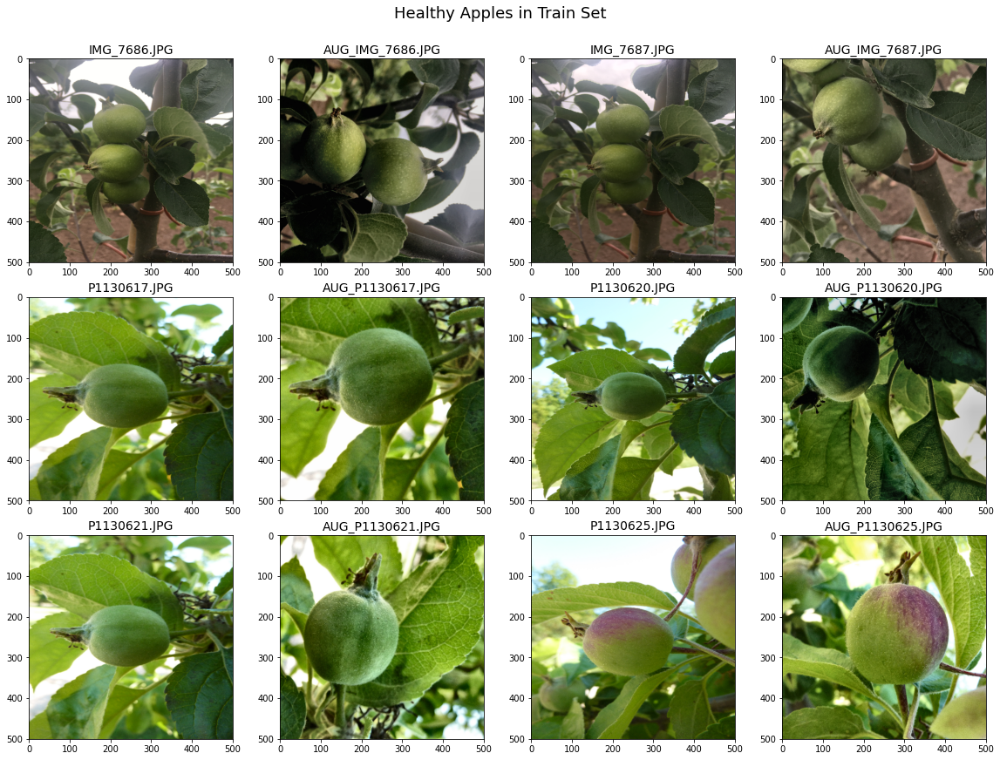

In [10]:
show_data(path=train_data_dir, label='healthy')

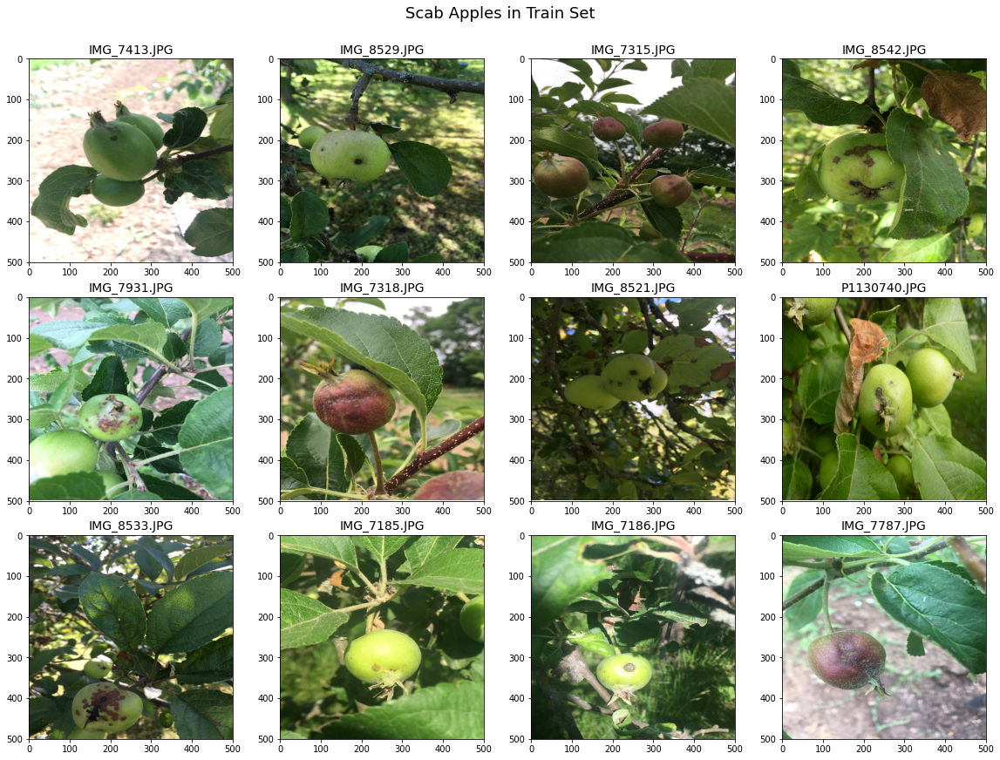

In [11]:
show_data(path=train_data_dir, label='scab')

# Image Data Generators

In [12]:
img_width, img_height, channels = 224, 224, 3
batch_size = 16

In [13]:
train_datagen = ImageDataGenerator(
    rescale= 1./255,
    horizontal_flip= True,
    rotation_range= 10,
    width_shift_range= 0.15,
    height_shift_range= 0.15,   
    fill_mode= 'constant',
)

test_datagen = ImageDataGenerator(
    rescale= 1./255, 
)

In [14]:
train_generator = train_datagen.flow_from_directory(  
    train_data_dir,  
    target_size= (img_width, img_height), 
    color_mode= 'rgb',
    batch_size= batch_size, 
    class_mode= 'categorical',
    shuffle= True, 
    seed= 42,
) 

test_generator = test_datagen.flow_from_directory(
    test_data_dir,
    target_size= (img_width, img_height),
    color_mode= 'rgb',
    batch_size= int(batch_size/4),  
    class_mode= 'categorical',
    shuffle= True, 
)

Found 347 images belonging to 2 classes.
Found 28 images belonging to 2 classes.


In [15]:
num_classes = len(train_generator.class_indices)  
train_labels = train_generator.classes 
train_labels = to_categorical(train_labels, num_classes=num_classes)
test_labels = test_generator.classes 
test_labels = to_categorical(test_labels, num_classes=num_classes)
num_train_samples = len(train_generator.filenames)  
num_test_samples = len(test_generator.filenames)  

print(f'No. of samples in train set: {num_train_samples}\nNo. of samples in test set: {num_test_samples}\n')

No. of samples in train set: 347
No. of samples in test set: 28



In [16]:
steps_per_epoch = np.ceil(float(num_train_samples) / float(batch_size))
print('steps_per_epoch: ', steps_per_epoch)
validation_steps = np.ceil(float(num_test_samples) / float(batch_size/4)) - 1
print('validation_steps: ', validation_steps)

steps_per_epoch:  22.0
validation_steps:  6.0


## Estimating Class Weights of the Unbalanced Dataset

In [18]:
class_weights = class_weight.compute_class_weight(
    'balanced', 
    np.unique(train_generator.classes),
    train_generator.classes
)

class_weights = {i : class_weights[i] for i in range(2)}

print(class_weights)

{0: 1.1121794871794872, 1: 0.9083769633507853}


# VGG16 CNN Model Pre-trained on ImageNet Dataset

- The model has two components:

	- VGG16 Feature Extractor (Pre-trained on the ImageNet dataset).
	- Classifier: A custom classifier is designed for the problem statement. Drop-out layers are stacked in between the dense layers to avoid overfitting.

The layers in the VGG16 feature extractor are kept frozen, and only the custom classifier is trained on the dataset.


In [19]:
def create_model(width=480, height=480, channel=3, classes=2):
    vgg16 = VGG16(include_top= False, input_shape= (width, height, channel), weights= 'imagenet')
    
    model = Sequential()
    
    # Stacking pre-trained VGG16 layers in the model
    for layer in vgg16.layers:
        model.add(layer)

    # Freezing feature extracter (i.e. VGG16 model layers)
    for layer in model.layers:
        layer.trainable= False

    # Adding custom classifier
    model.add(GlobalAveragePooling2D())
    model.add(Dense(128, kernel_initializer='normal', activation='relu'))
    model.add(Dropout(0.1))
    model.add(Dense(64, kernel_initializer='normal', activation='relu'))
    model.add(Dropout(0.2))
    model.add(Dense(32, kernel_initializer='normal', activation='relu'))
    model.add(Dropout(0.3))
    model.add(Dense(16, kernel_initializer='normal', activation='relu'))
    model.add(Dropout(0.4))
    model.add(Dense(classes, kernel_initializer='normal', activation='softmax'))

    model.summary()
    
    return model

In [20]:
model = create_model(width=img_width, height=img_height, channel=channels, classes=num_classes)

2021-12-04 10:36:17.121878: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-04 10:36:17.231314: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-04 10:36:17.232106: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-12-04 10:36:17.233323: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compil

58900480/58889256 [==============================] - 1s 0us/step
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
_________________________________________________________

### Model Architecture

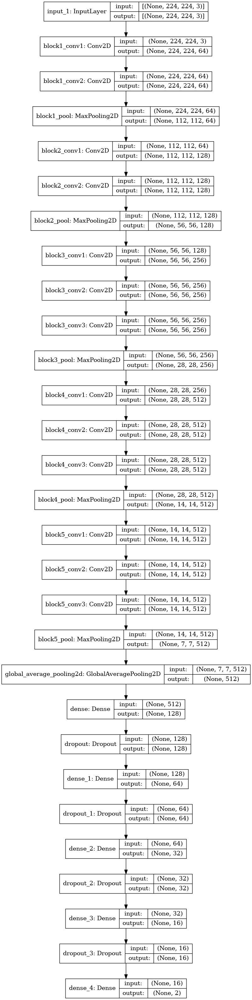

In [21]:
SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True, expand_nested=True)

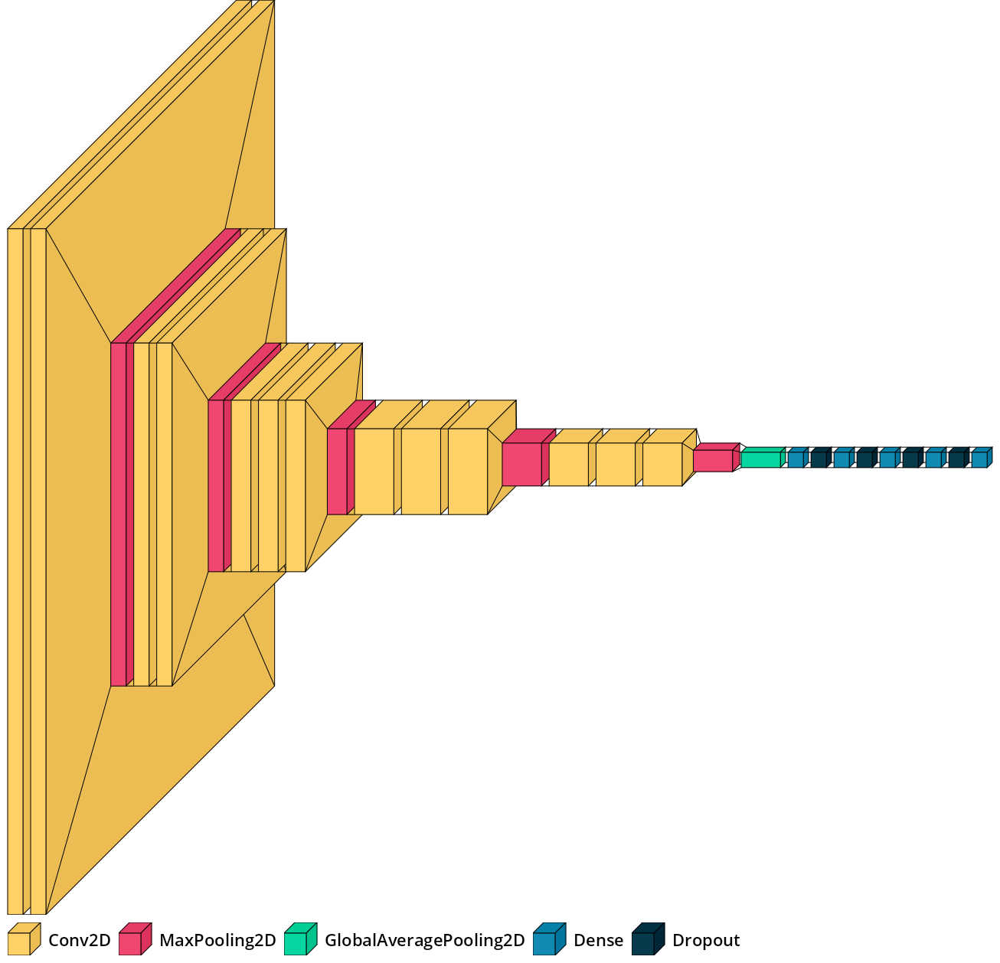

In [22]:
font = ImageFont.truetype("../input/pillow-fonts/fonts/OpenSans-Semibold.ttf", 22)
visualkeras.layered_view(model, legend=True, font=font, to_file='model_architecture.png', draw_volume=True)

## Callbacks

1. **Exponential learning rate decay scheduler -** Exponentially lowers the learning rate as the training progresses.
2. **Model Checkpoint -** Saves "best" model (according to the quantity monitored, i.e. `val_loss`).
3. **Early Stopping -** Stops training when a monitored `val_loss` has stopped improving.
4. **CSV Logger -** Streams epoch results to the `model_training.csv` file.

In [23]:
def exponential_decay(lr0, s):
    def exponential_decay_fn(epoch):
        return lr0 * 0.1 **(epoch / s)
    return exponential_decay_fn

exponential_decay_fn = exponential_decay(0.001, 20)

lr_scheduler = LearningRateScheduler(
    exponential_decay_fn,
    verbose=1
)

checkpoint = ModelCheckpoint(
    'model.h5',
    monitor='val_loss',
    verbose=1,
    save_best_only=True,
    mode='auto',
#     save_weights_only=False,
    period=1
)

earlystop = EarlyStopping(
    monitor='val_loss',
    min_delta=0.001,
    patience=8,
    verbose=1,
    mode='auto'
)

csvlogger = CSVLogger(
    filename= "model_training.csv",
    separator = ",",
    append = False
)

callbacks = [checkpoint, earlystop, csvlogger, lr_scheduler]

# Model Training

- Optimizer - Adam
- Initial learning rate - 0.001
- Loss - Categorical crossentropy
- Metric - Accuracy

In [24]:
model.compile(optimizer=Adam(learning_rate= 0.001), loss= 'categorical_crossentropy', metrics= ['accuracy'])

In [25]:
history = model.fit(
    train_generator, 
    epochs = 30,
    steps_per_epoch = steps_per_epoch,
    validation_data = test_generator, 
    validation_steps = validation_steps,
    callbacks = callbacks,
    class_weight = class_weights,
    shuffle = True,
    verbose = 1,
)

2021-12-04 10:36:26.659482: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/30

Epoch 00001: LearningRateScheduler setting learning rate to 0.001.


2021-12-04 10:36:32.422972: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8005


22/22 [==============================] - 88s 4s/step - loss: 0.6934 - accuracy: 0.4669 - val_loss: 0.6934 - val_accuracy: 0.3750

Epoch 00001: val_loss improved from inf to 0.69344, saving model to model.h5
Epoch 2/30

Epoch 00002: LearningRateScheduler setting learning rate to 0.0008912509381337456.
22/22 [==============================] - 55s 3s/step - loss: 0.6936 - accuracy: 0.4352 - val_loss: 0.6931 - val_accuracy: 0.5000

Epoch 00002: val_loss improved from 0.69344 to 0.69312, saving model to model.h5
Epoch 3/30

Epoch 00003: LearningRateScheduler setting learning rate to 0.0007943282347242815.
22/22 [==============================] - 56s 3s/step - loss: 0.6932 - accuracy: 0.4640 - val_loss: 0.6931 - val_accuracy: 0.4583

Epoch 00003: val_loss did not improve from 0.69312
Epoch 4/30

Epoch 00004: LearningRateScheduler setting learning rate to 0.0007079457843841379.
22/22 [==============================] - 57s 3s/step - loss: 0.6925 - accuracy: 0.5447 - val_loss: 0.6919 - val_accu

## Model Training Plots

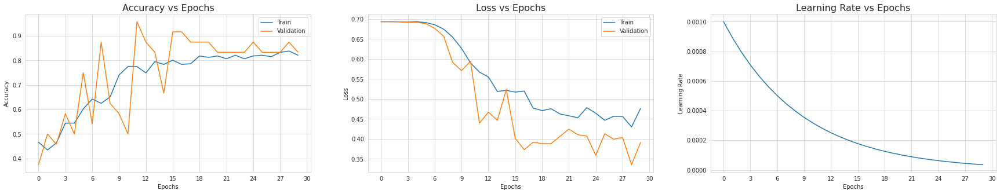

In [26]:
sns.set_style('whitegrid')
fig, ax = plt.subplots(1, 3, figsize=(30, 5))
ax = ax.ravel()
metrics = ['Accuracy', 'Loss', 'Learning Rate']

for i, met in enumerate(['accuracy', 'loss', 'lr']): 
    if met != 'lr':
        ax[i].plot(history.history[met])
        ax[i].plot(history.history['val_' + met])
        ax[i].set_title('{} vs Epochs'.format(metrics[i]), fontsize=16)
        ax[i].set_xlabel('Epochs')
        ax[i].set_ylabel(metrics[i])
        ax[i].set_xticks(np.arange(0,31,3))
        ax[i].legend(['Train', 'Validation'])
        ax[i].xaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
        ax[i].yaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
    else:
        ax[i].plot(history.history[met])
        ax[i].set_title('{} vs Epochs'.format(metrics[i]), fontsize=16)
        ax[i].set_xlabel('Epochs')
        ax[i].set_ylabel(metrics[i])
        ax[i].set_xticks(np.arange(0,31,3))
        ax[i].xaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
        ax[i].yaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
        
plt.savefig('model_metrics_plot.png', facecolor= 'w',transparent= False, bbox_inches= 'tight', dpi= 300)

## Evaluating Model on the Test Set

In [27]:
model.load_weights("./model.h5")

In [28]:
model.evaluate(test_generator, batch_size=batch_size, steps=8, verbose=1)

8/8 [==============================] - 5s 557ms/step - loss: 0.3665 - accuracy: 0.8571


[0.36652013659477234, 0.8571428656578064]

## Confusion Matrix

In [29]:
Y_pred = model.predict(test_generator, num_test_samples // batch_size+1)
y_pred = np.argmax(Y_pred, axis=1)
cm = confusion_matrix(test_generator.classes, y_pred)
df_cm = pd.DataFrame(cm, list(test_generator.class_indices.keys()), list(test_generator.class_indices.keys()))
df_cm

,Healthy,Scab
Healthy,5,7
Scab,5,11


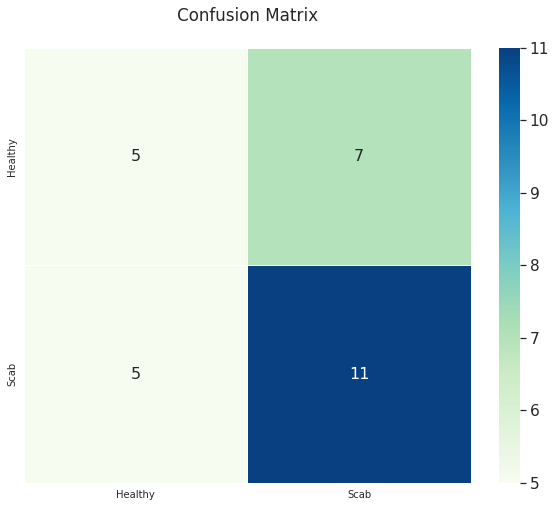

In [30]:
fig, ax = plt.subplots(figsize=(10,8))
sns.set(font_scale=1.4) # for label size
sns.heatmap(df_cm, linewidths=1.0, annot=True, annot_kws={"size": 16}, cmap=plt.cm.GnBu)
plt.title('Confusion Matrix\n')
plt.savefig('confusion_matrix.png', transparent= False, bbox_inches= 'tight', dpi= 300)
plt.show()

## Classification Report

In [31]:
print('Classification Report\n')
target_names = list(test_generator.class_indices.keys())
print(classification_report(test_generator.classes, y_pred, target_names=target_names))

Classification Report

              precision    recall  f1-score   support

     Healthy       0.50      0.42      0.45        12
        Scab       0.61      0.69      0.65        16

    accuracy                           0.57        28
   macro avg       0.56      0.55      0.55        28
weighted avg       0.56      0.57      0.56        28



# Activations (Outputs) Visualization 

In [32]:
!mkdir activations

In [33]:
image = load_img(f'{test_data_dir}Scab/IMG_8891.JPG', target_size= (img_width, img_height))
image = img_to_array(image)
image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
image = preprocess_input(image)
y_hat = model.predict(image)

input_1 (1, 224, 224, 3) 


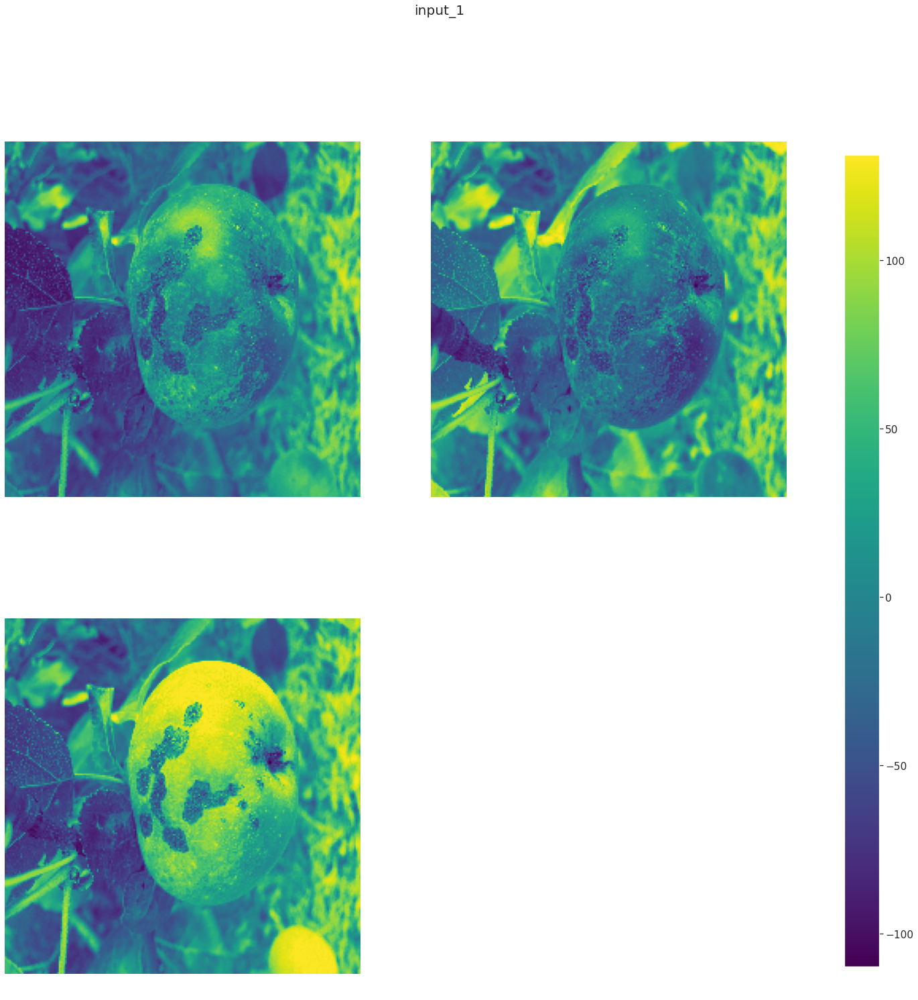

block1_conv1 (1, 224, 224, 64) 


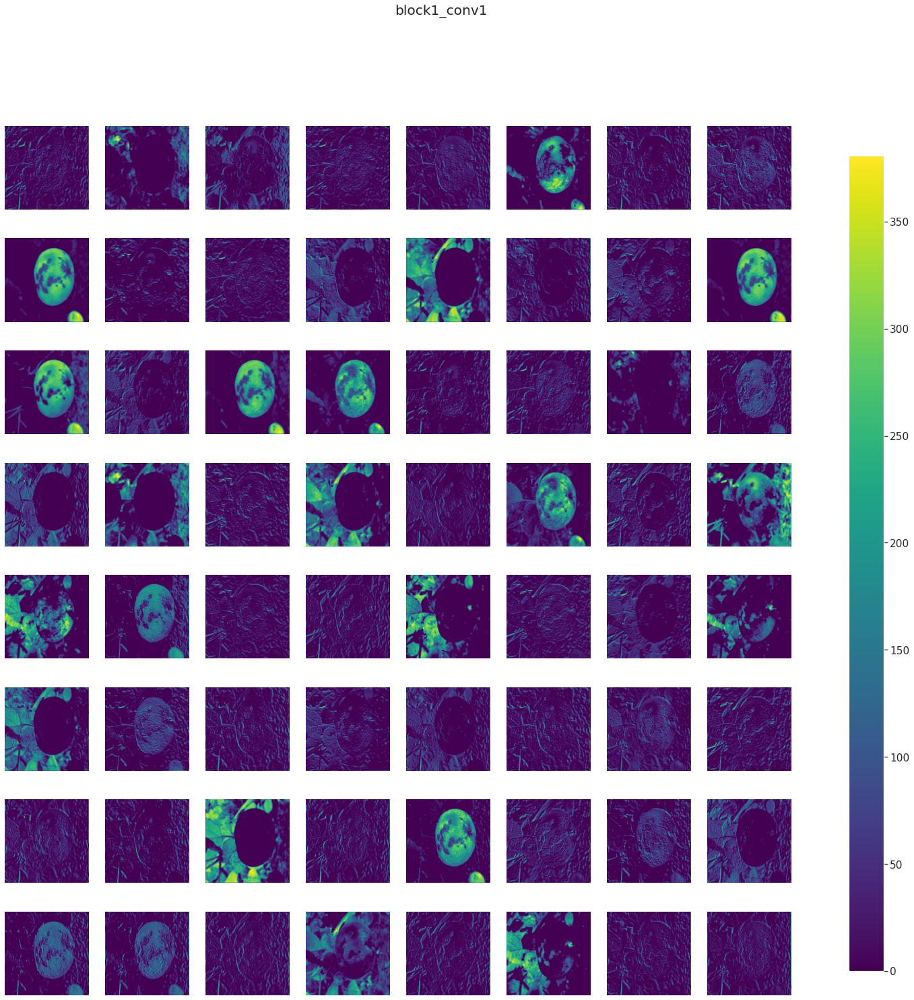

block1_conv2 (1, 224, 224, 64) 


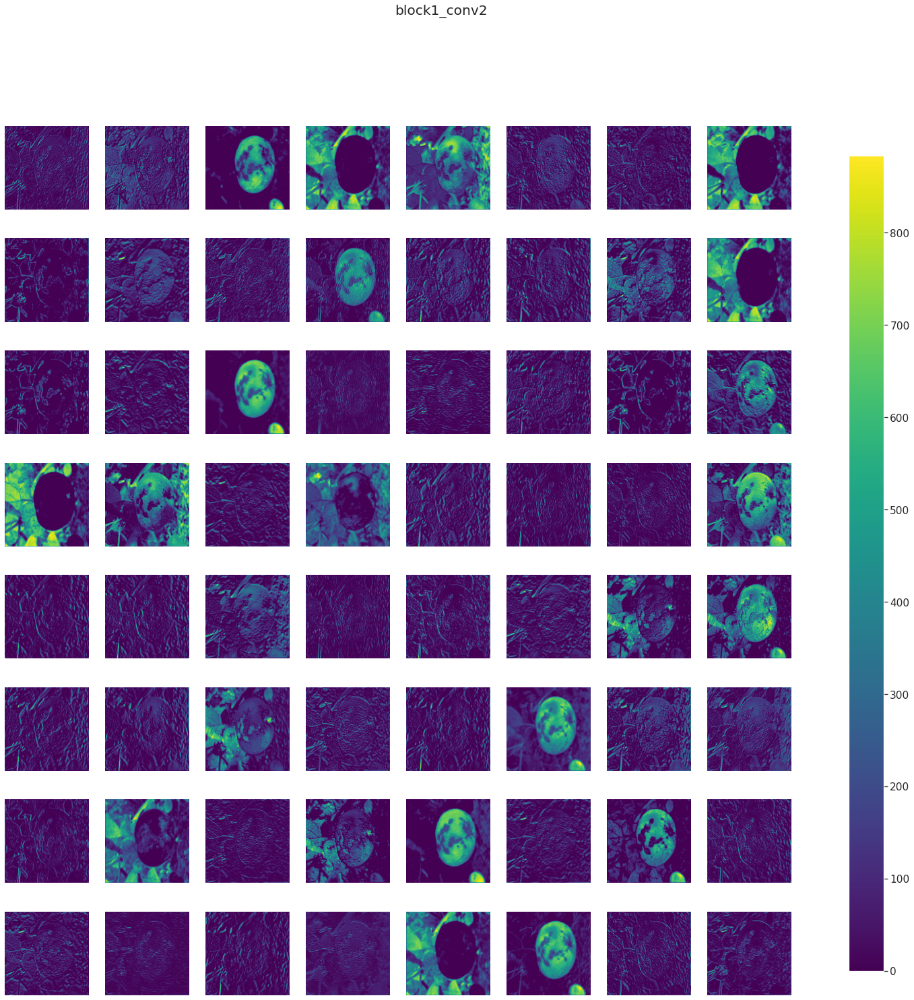

block1_pool (1, 112, 112, 64) 


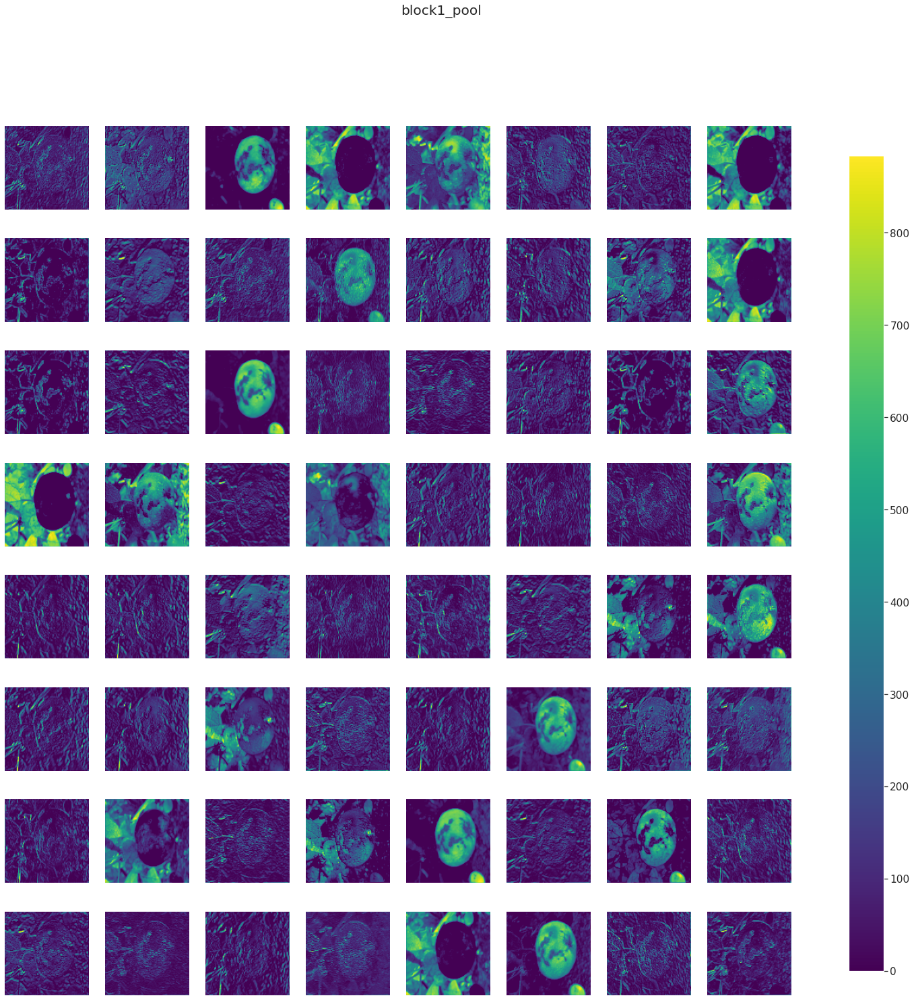

block2_conv1 (1, 112, 112, 128) 


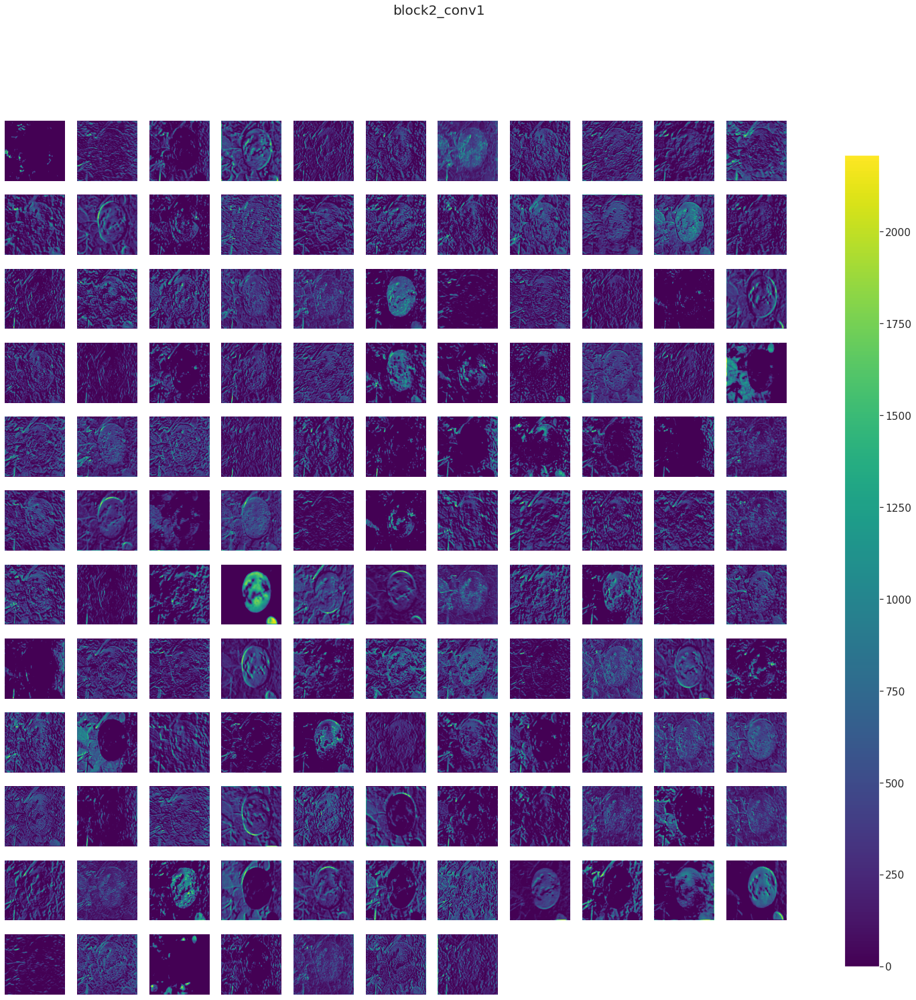

block2_conv2 (1, 112, 112, 128) 


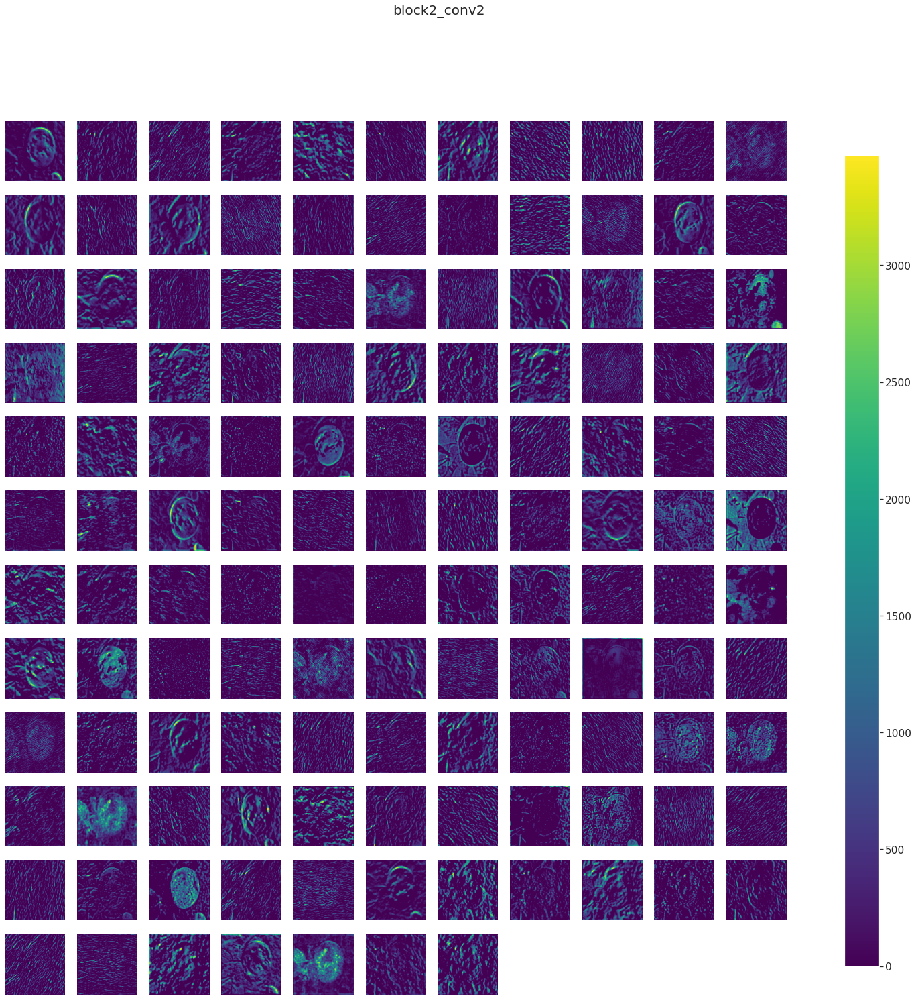

block2_pool (1, 56, 56, 128) 


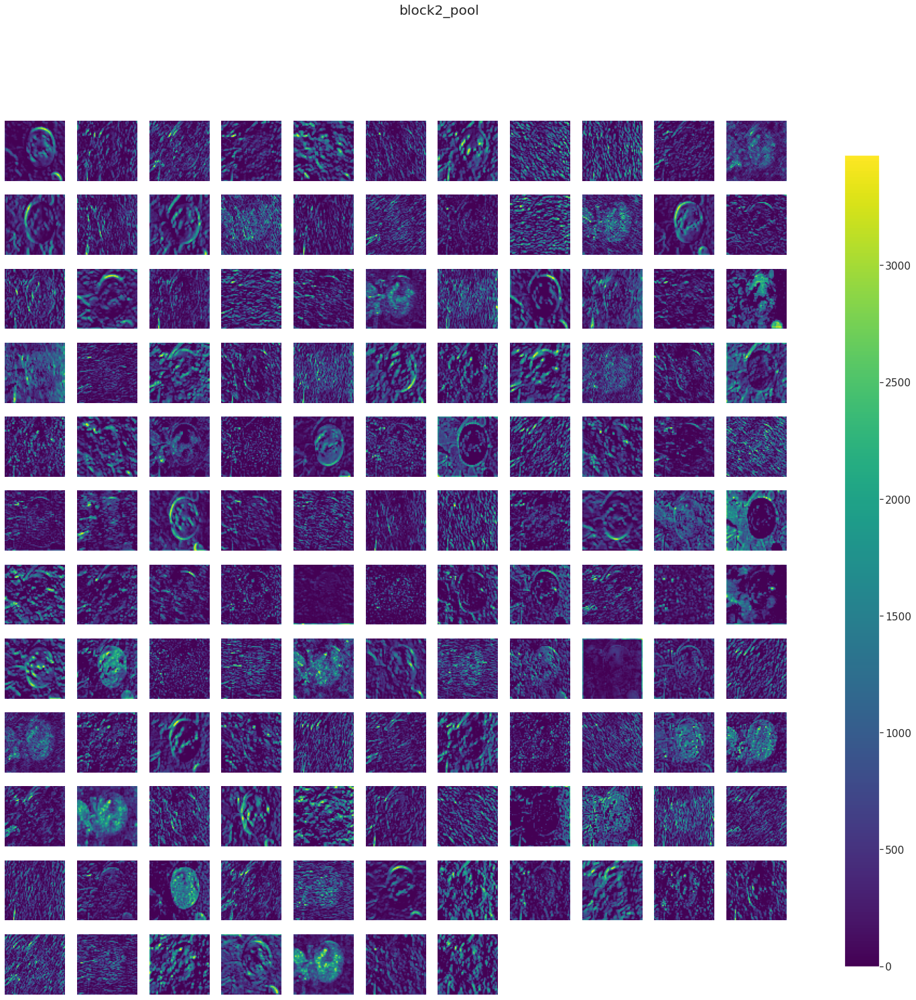

block3_conv1 (1, 56, 56, 256) 


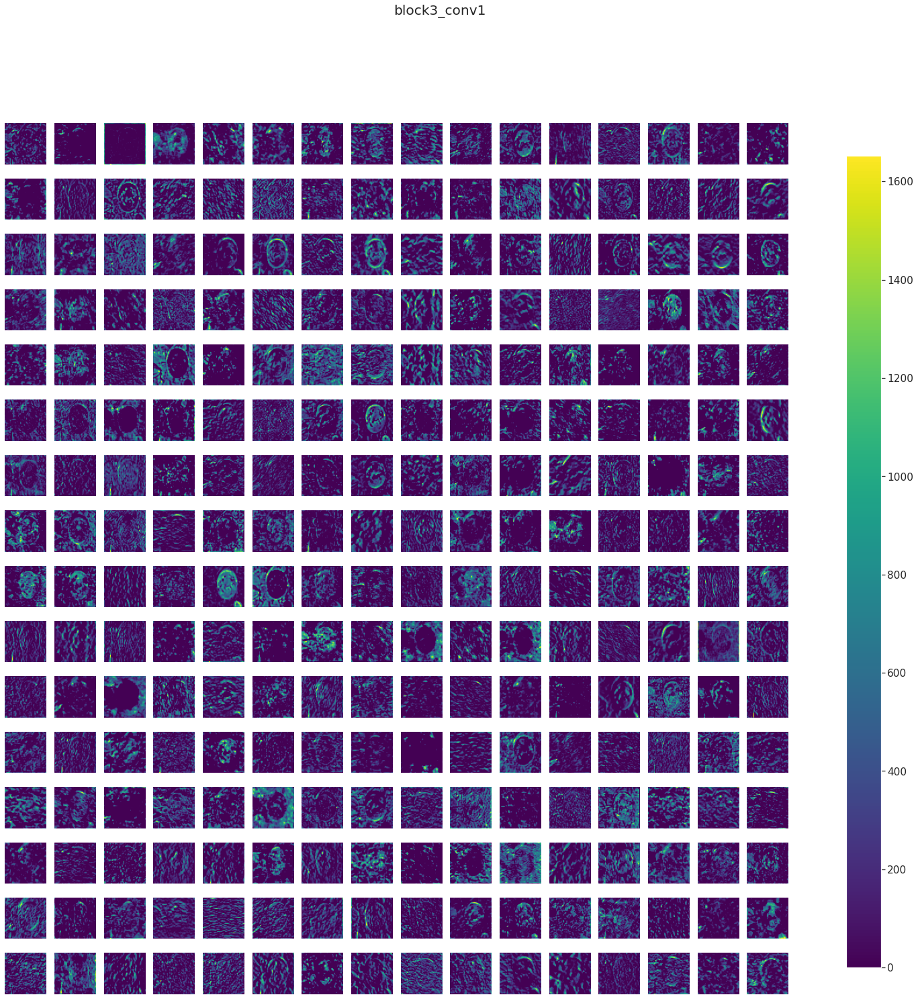

block3_conv2 (1, 56, 56, 256) 


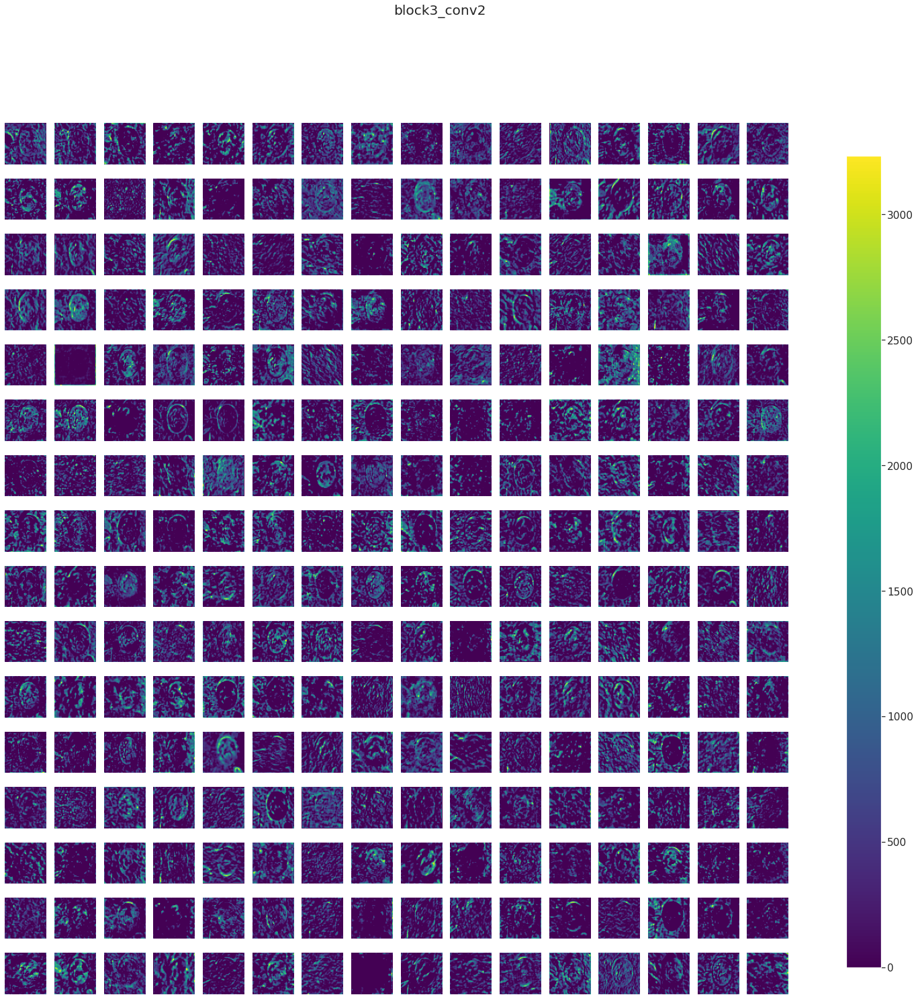

block3_conv3 (1, 56, 56, 256) 


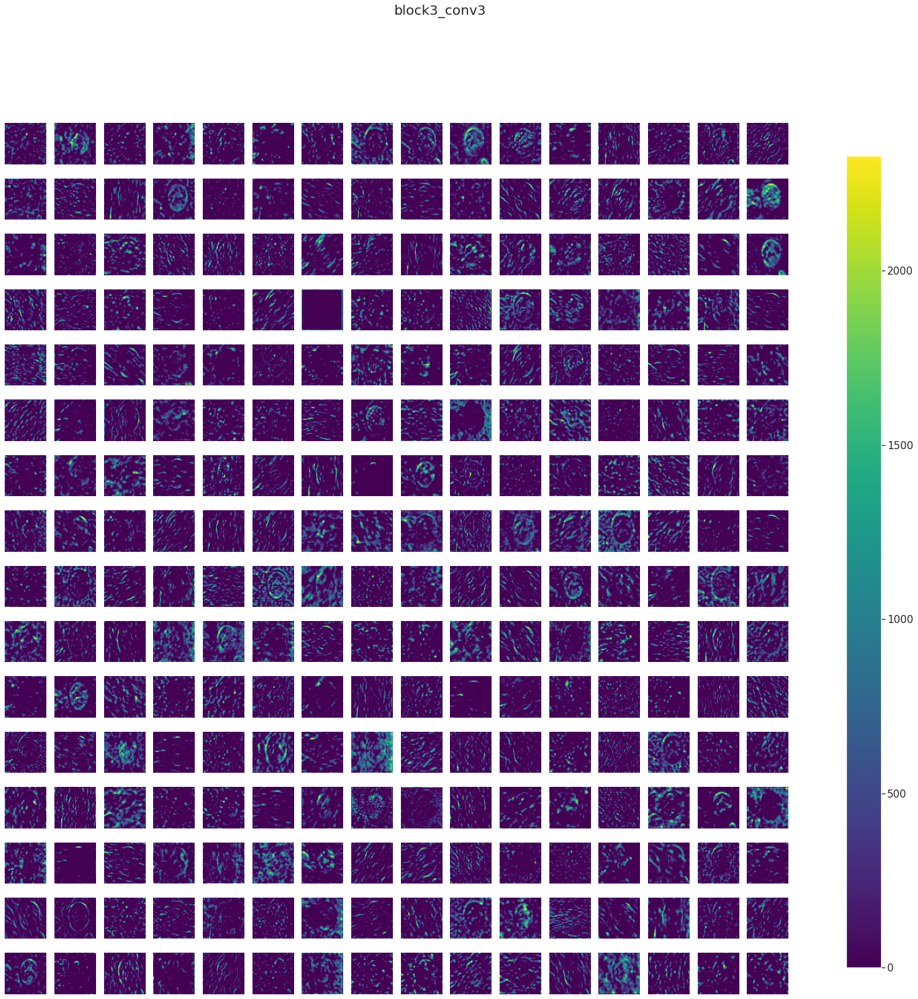

block3_pool (1, 28, 28, 256) 


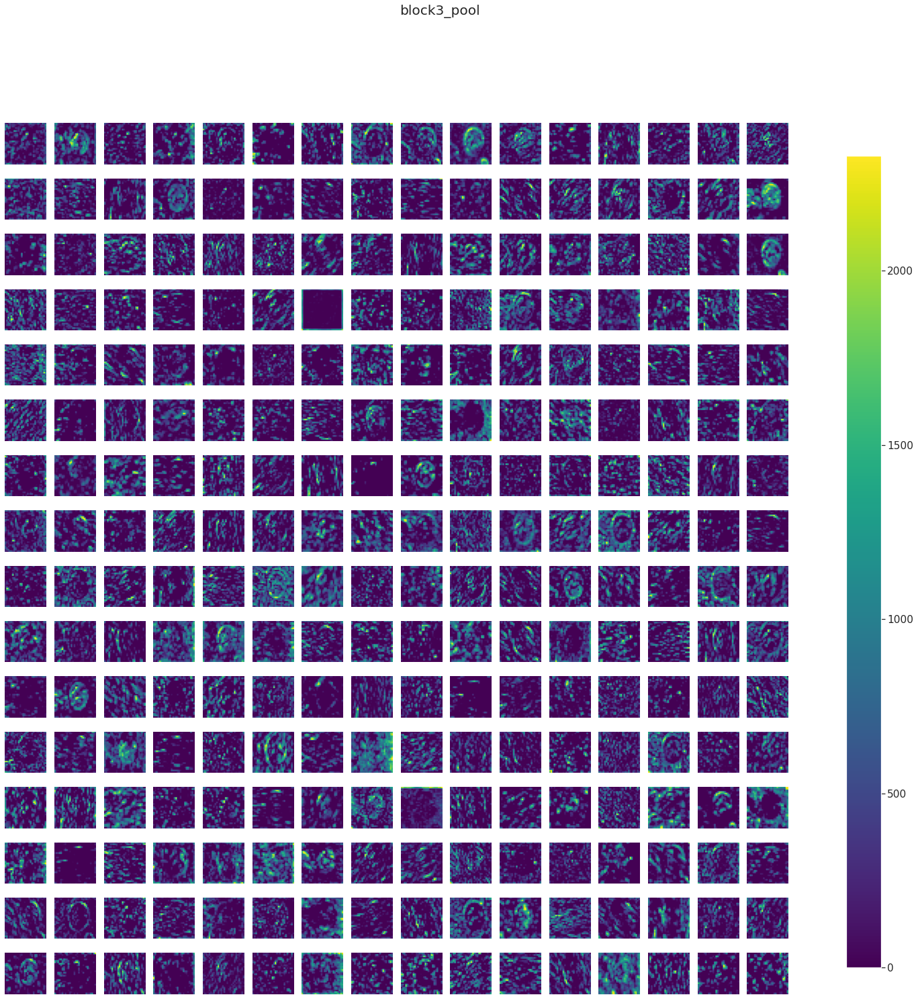

block4_conv1 (1, 28, 28, 512) 


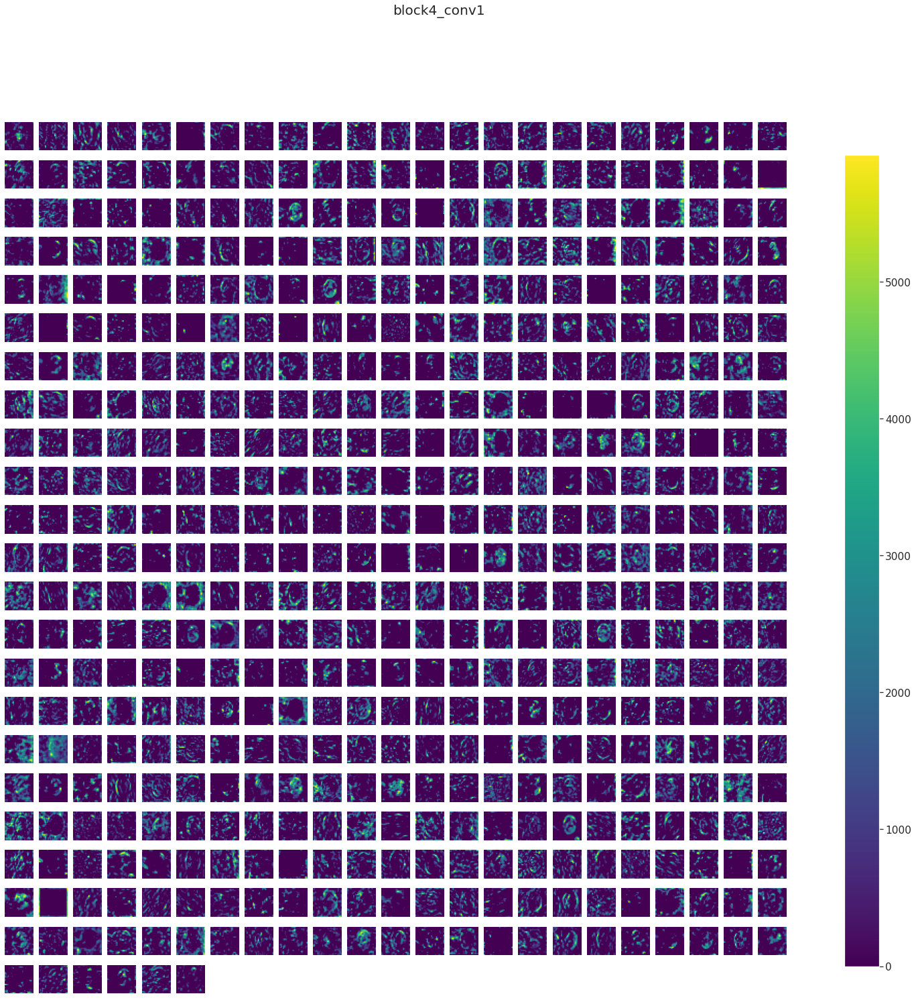

block4_conv2 (1, 28, 28, 512) 


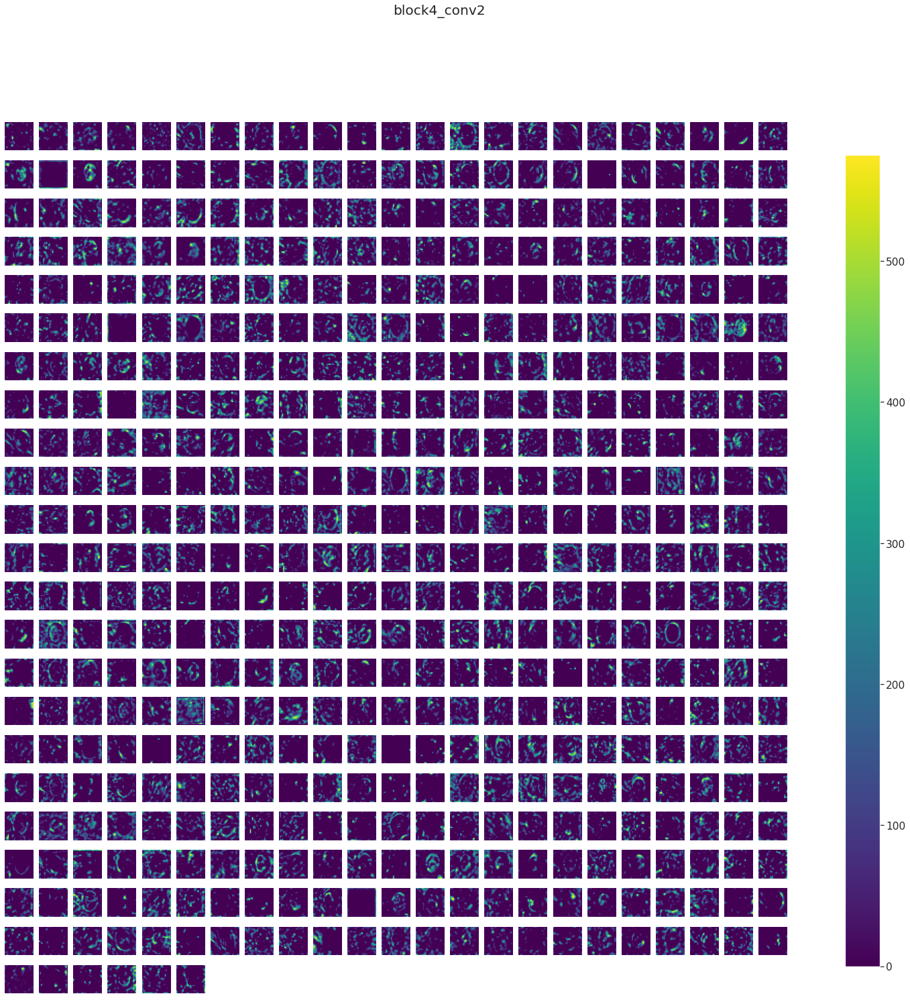

block4_conv3 (1, 28, 28, 512) 


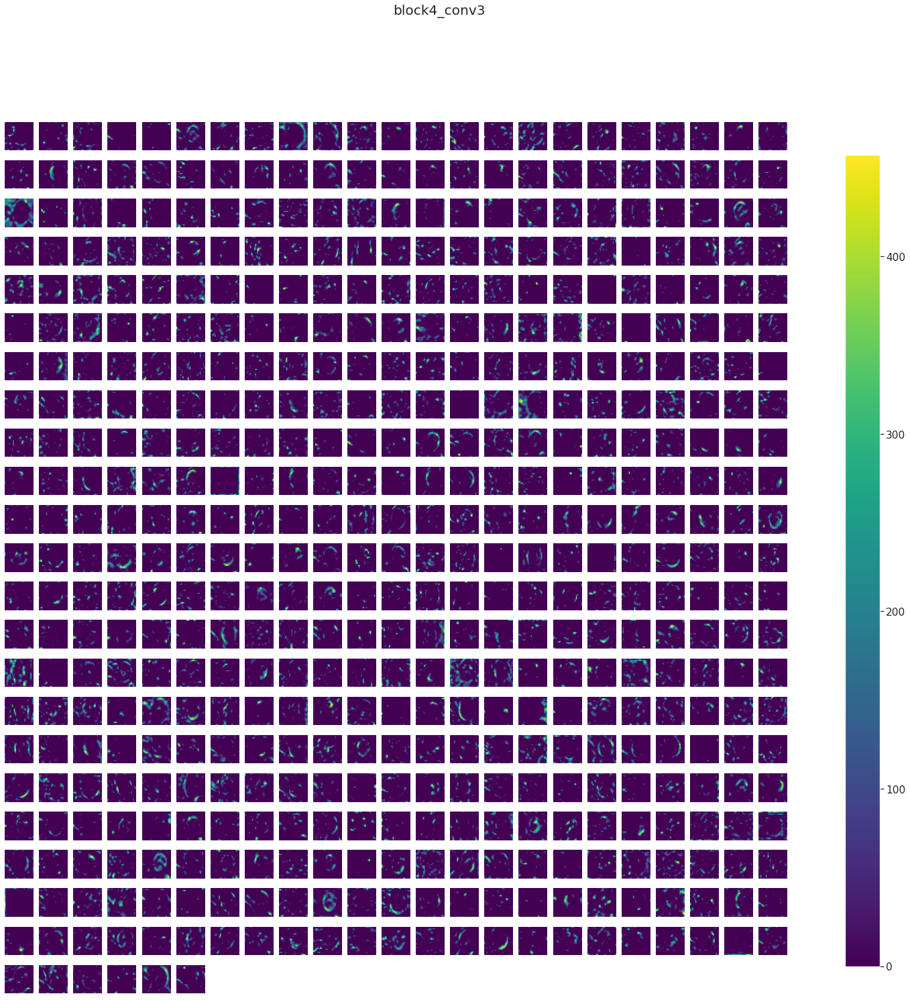

block4_pool (1, 14, 14, 512) 


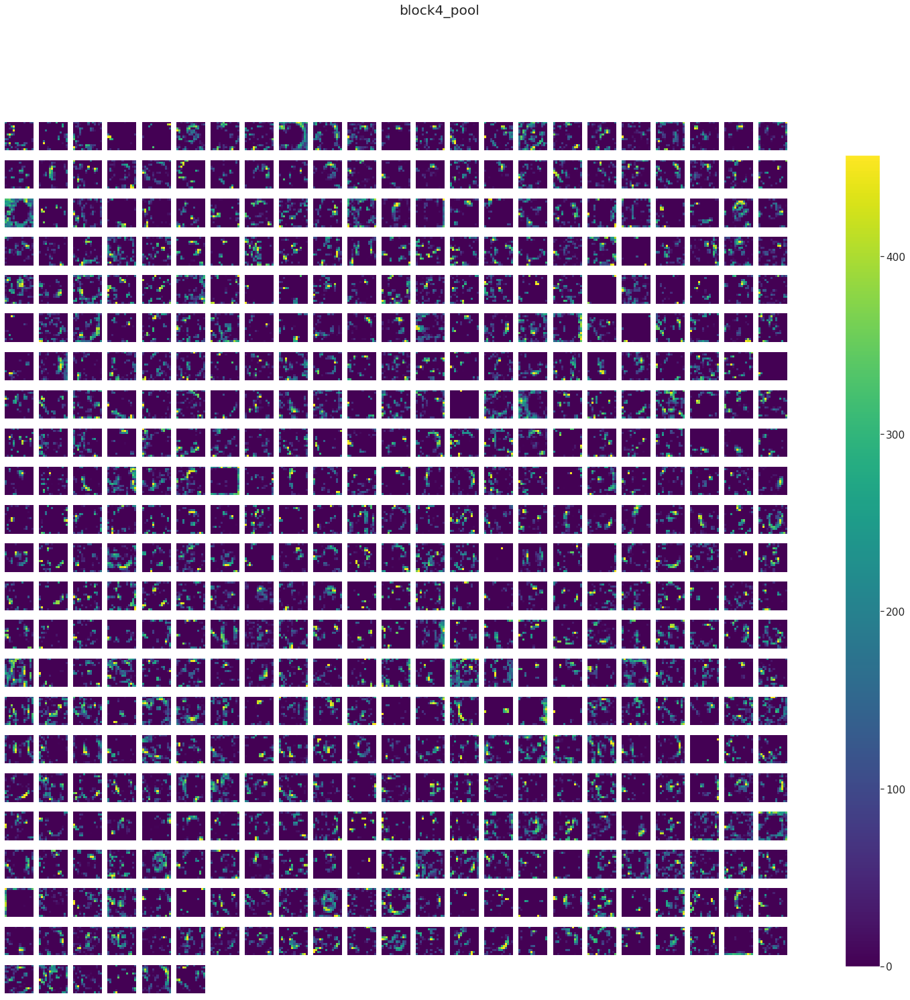

block5_conv1 (1, 14, 14, 512) 


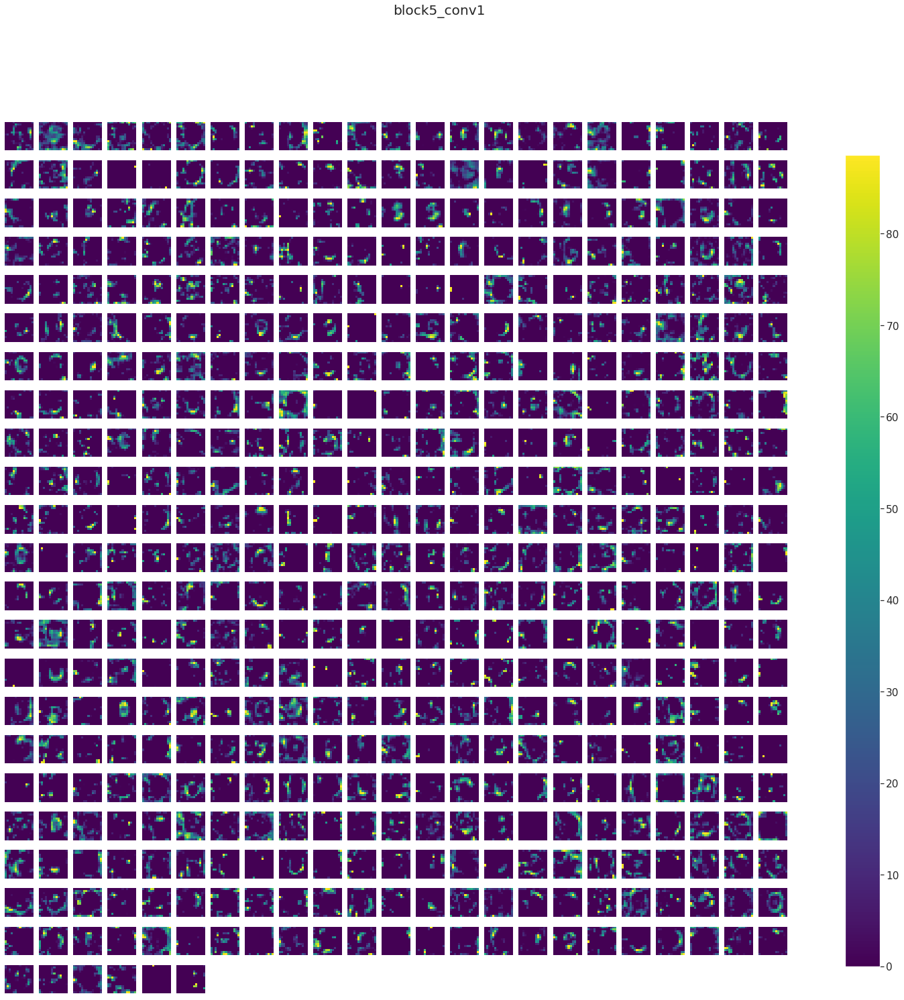

block5_conv2 (1, 14, 14, 512) 


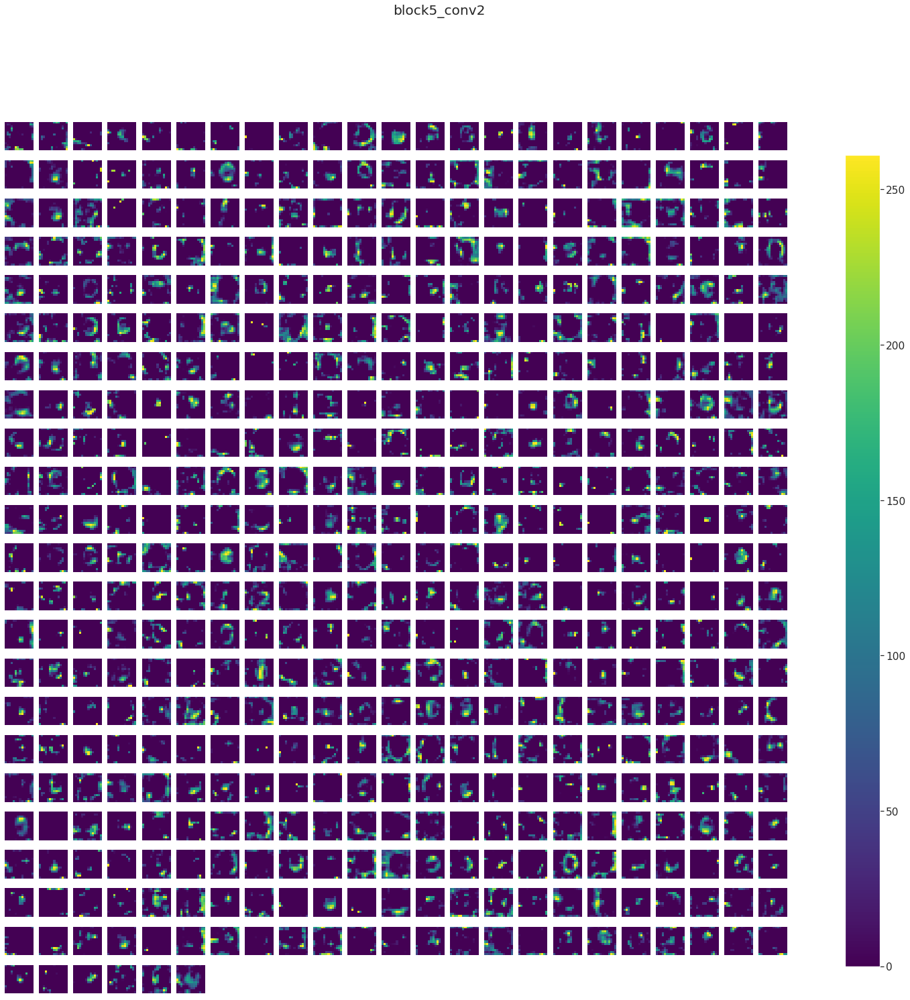

block5_conv3 (1, 14, 14, 512) 


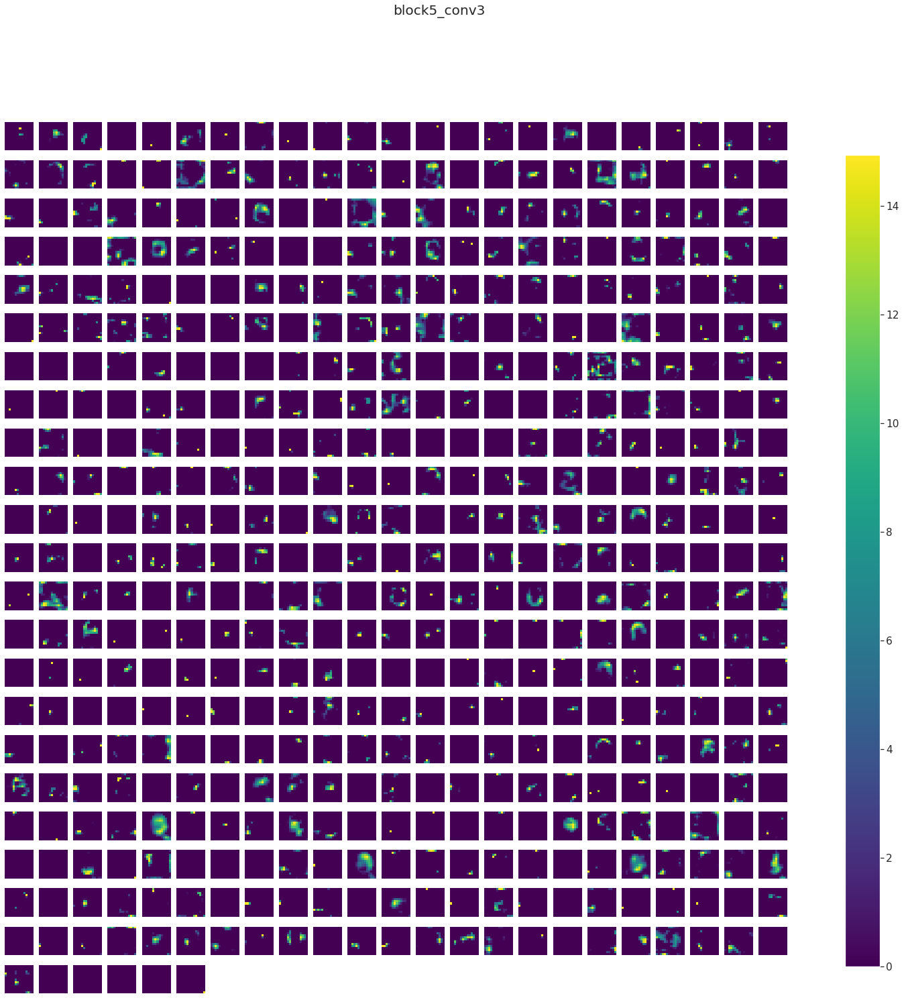

block5_pool (1, 7, 7, 512) 


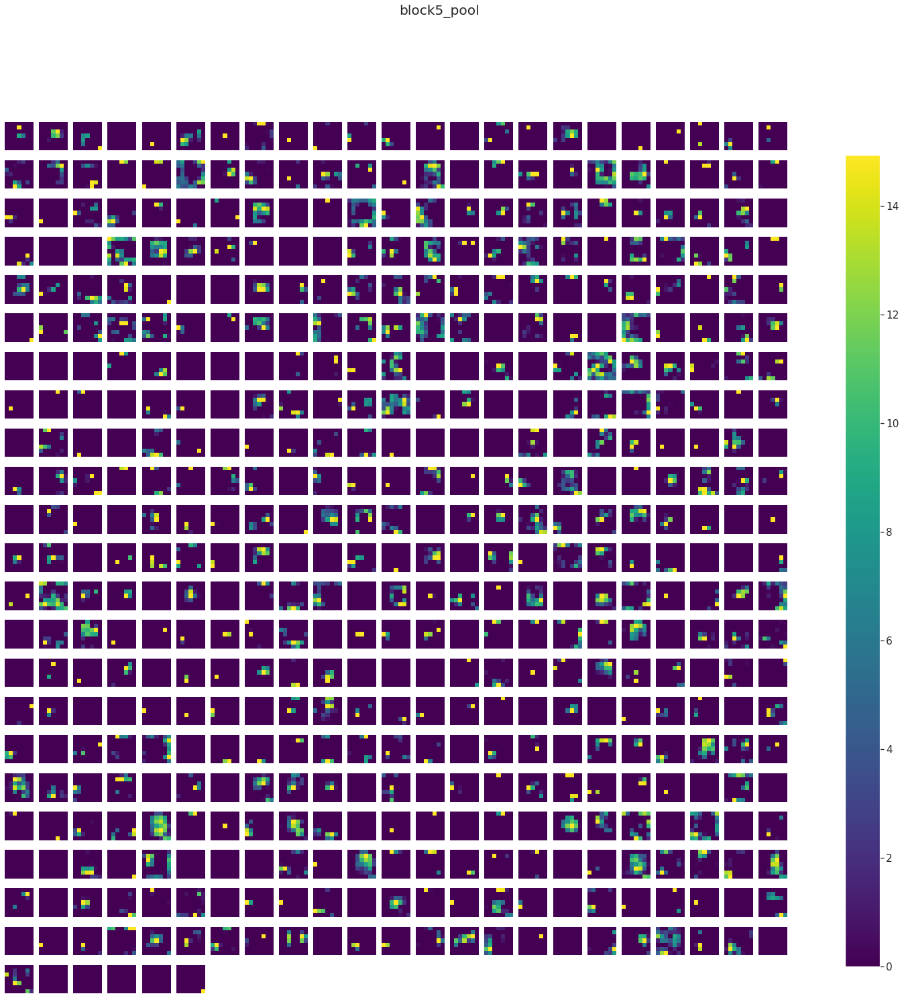

global_average_pooling2d (1, 512) 


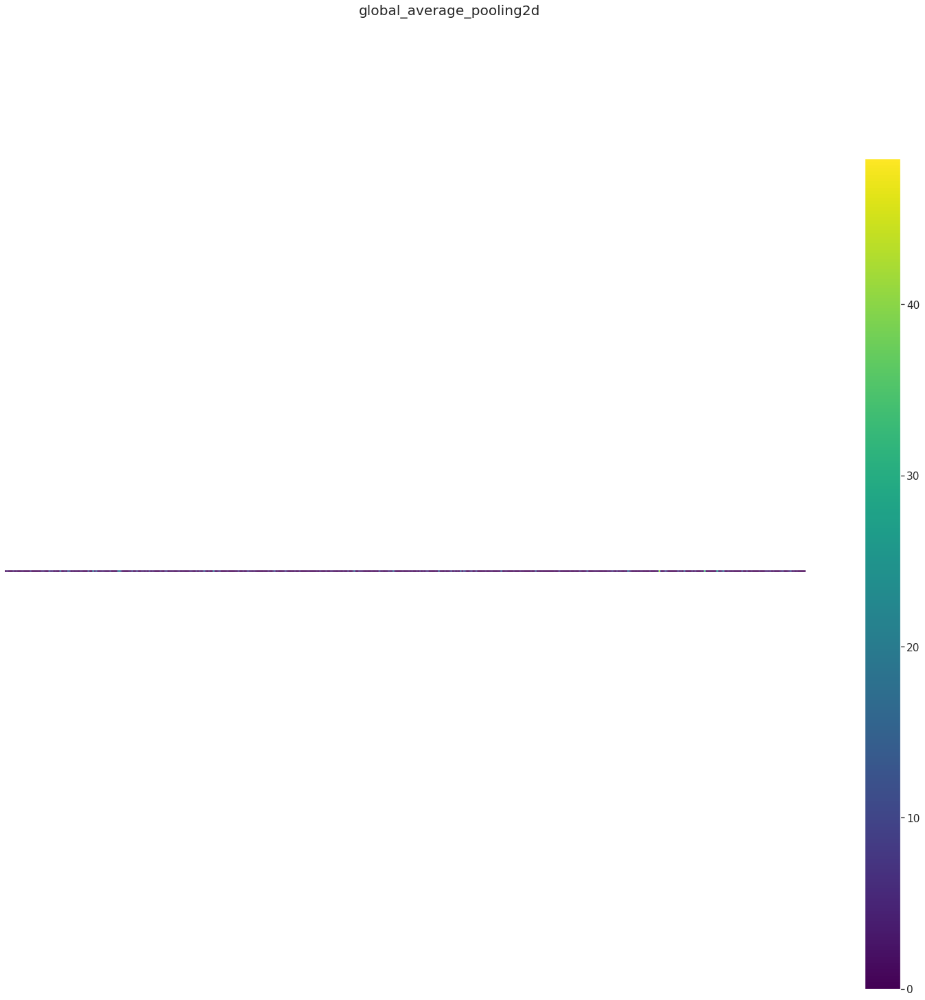

dense (1, 128) 


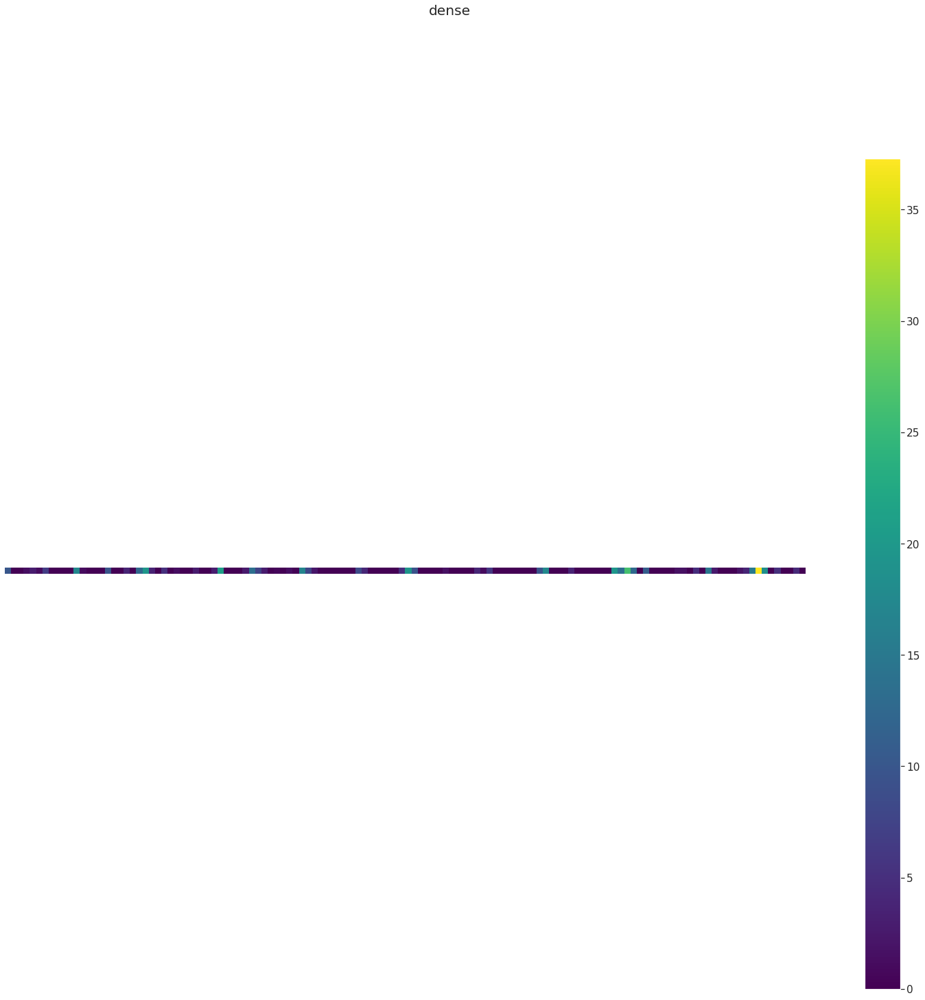

dropout (1, 128) 


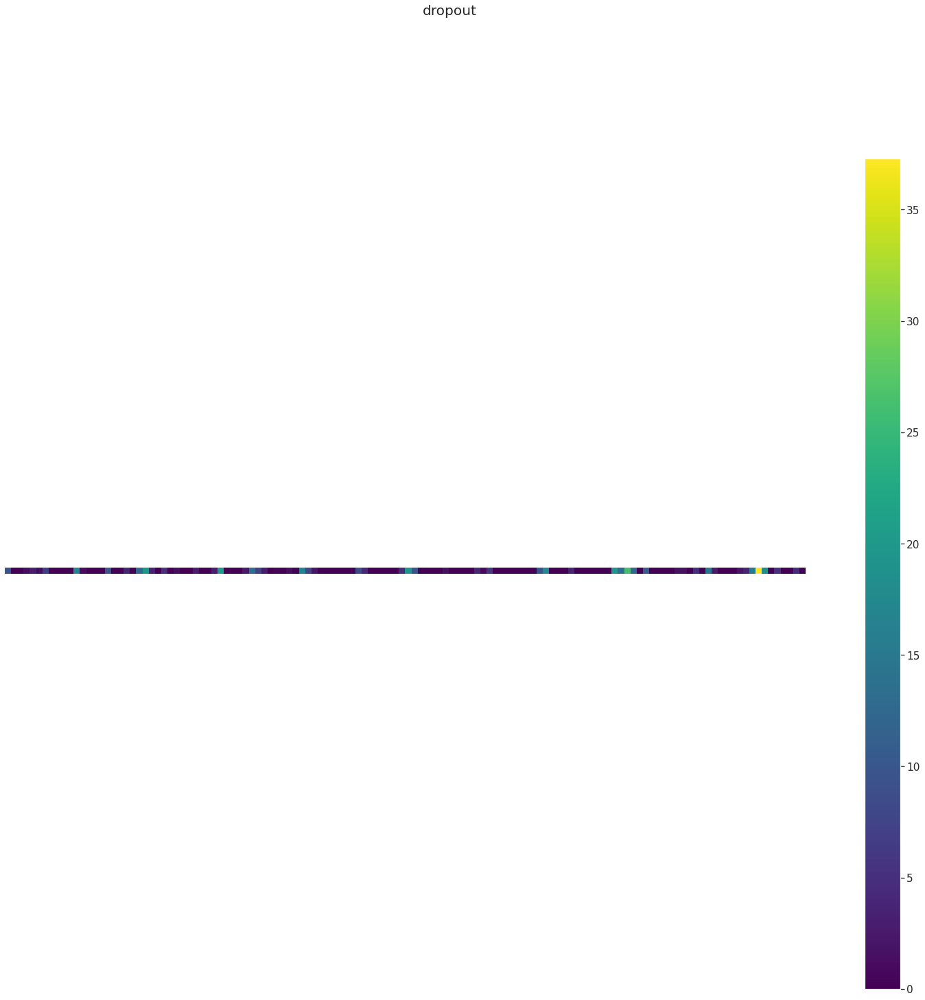

dense_1 (1, 64) 


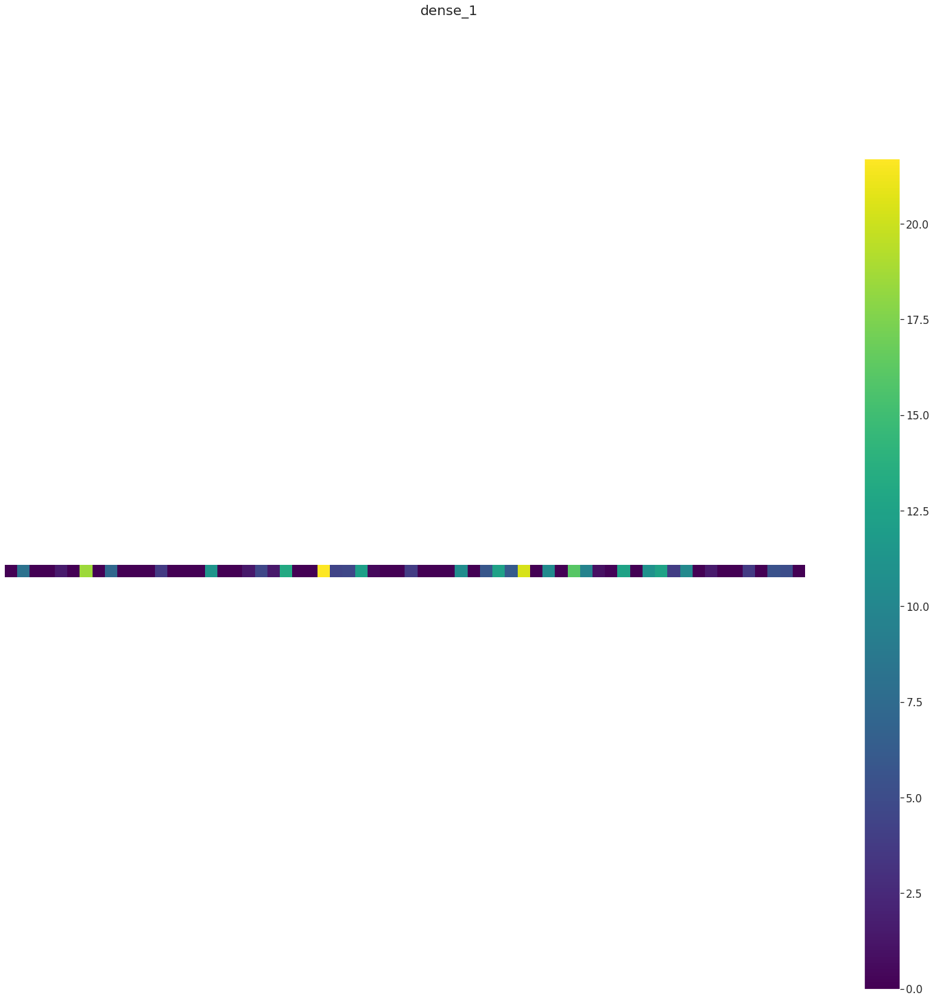

dropout_1 (1, 64) 


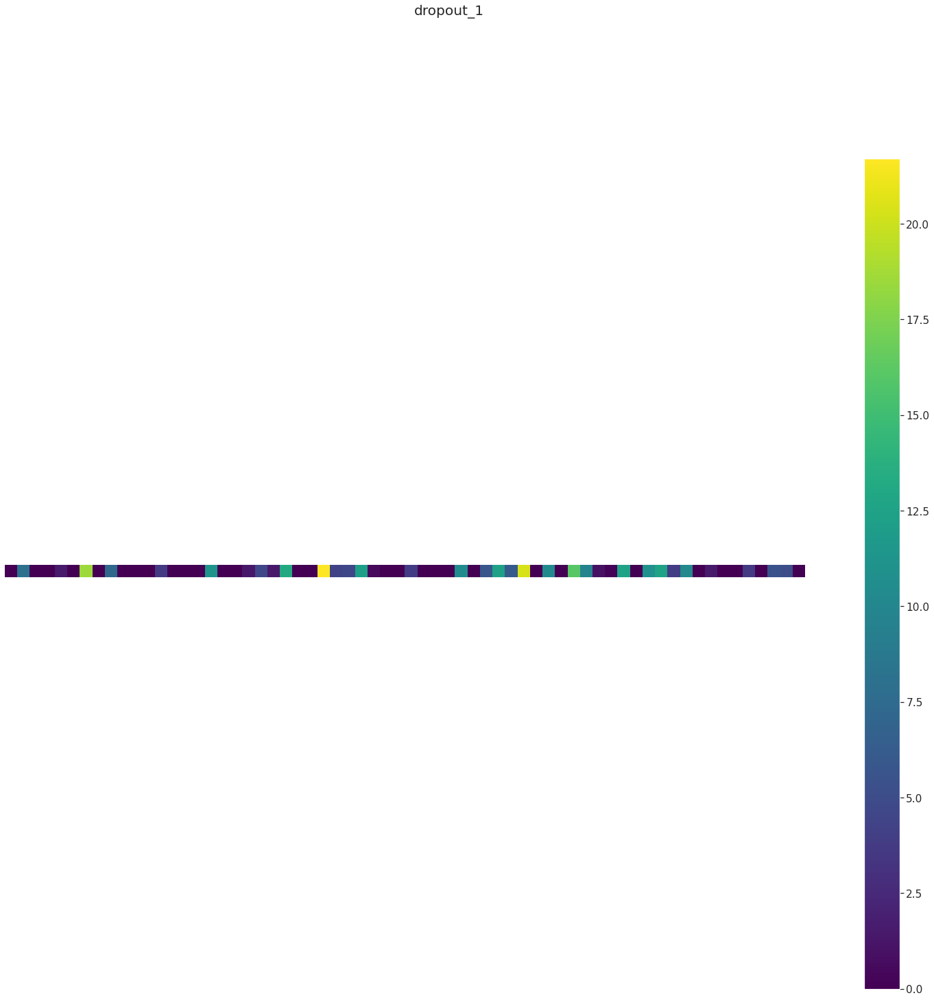

dense_2 (1, 32) 


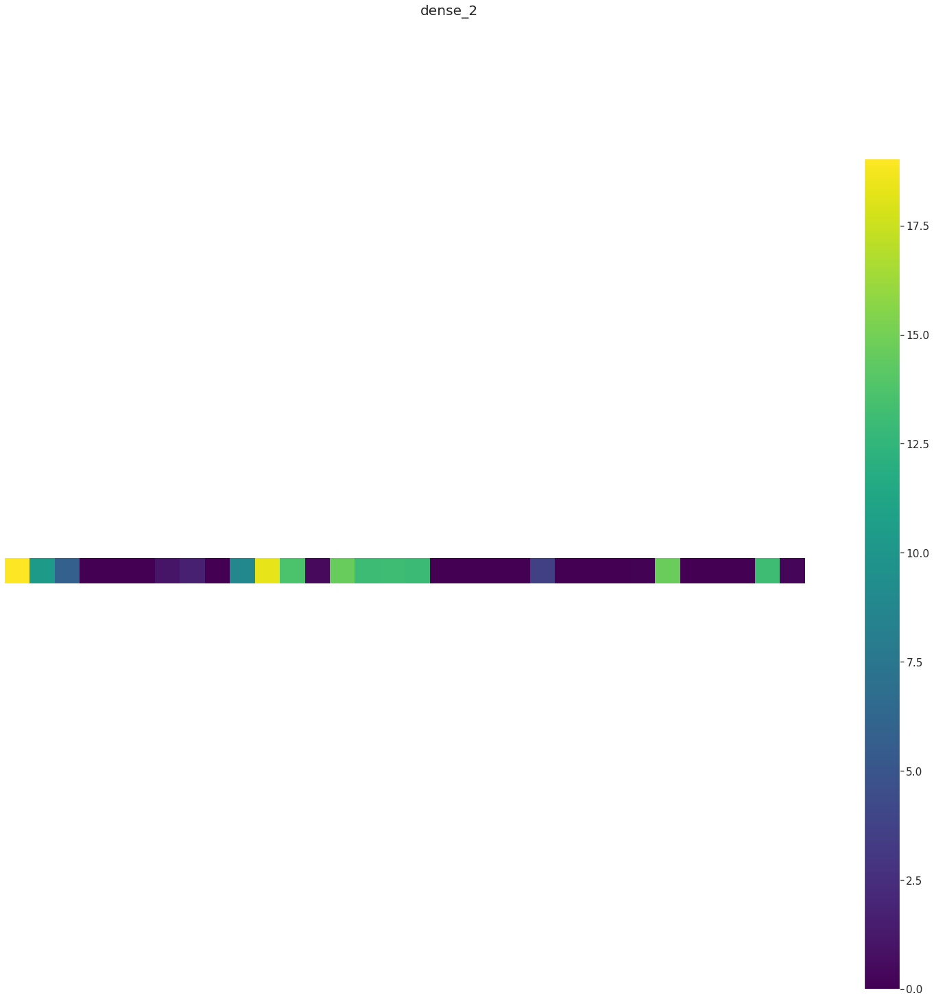

dropout_2 (1, 32) 


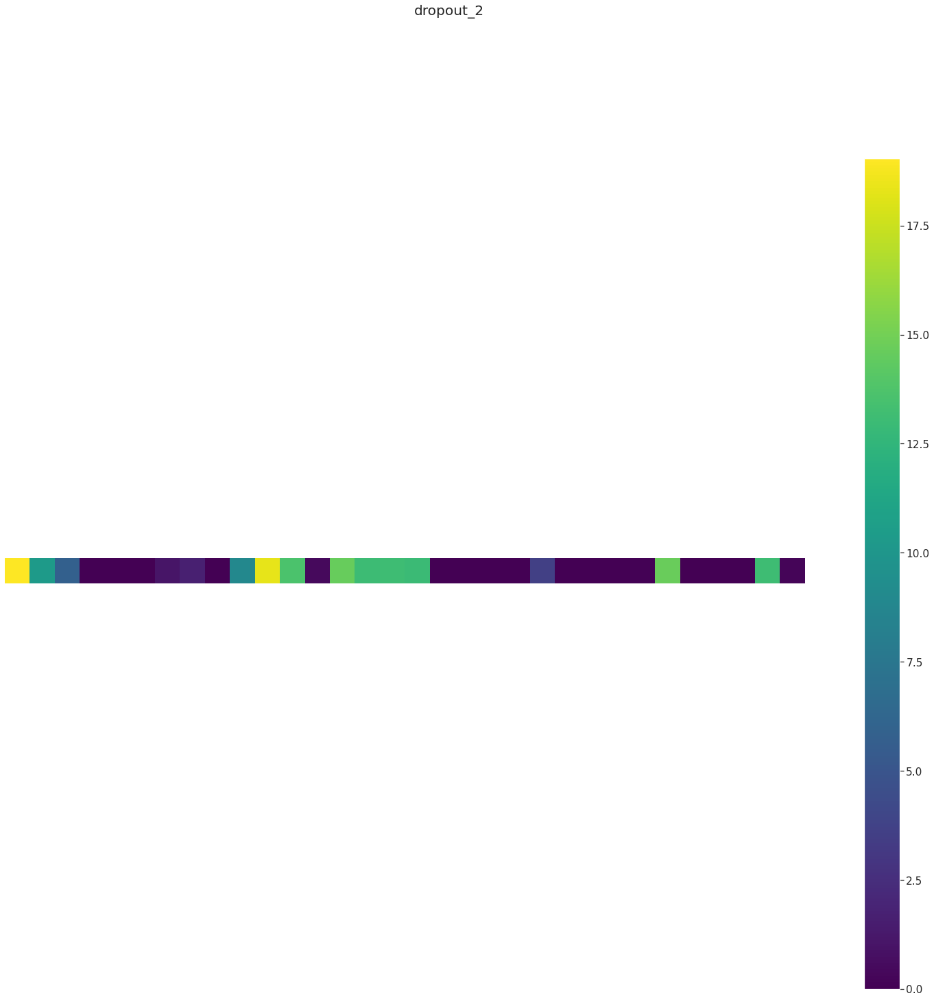

dense_3 (1, 16) 


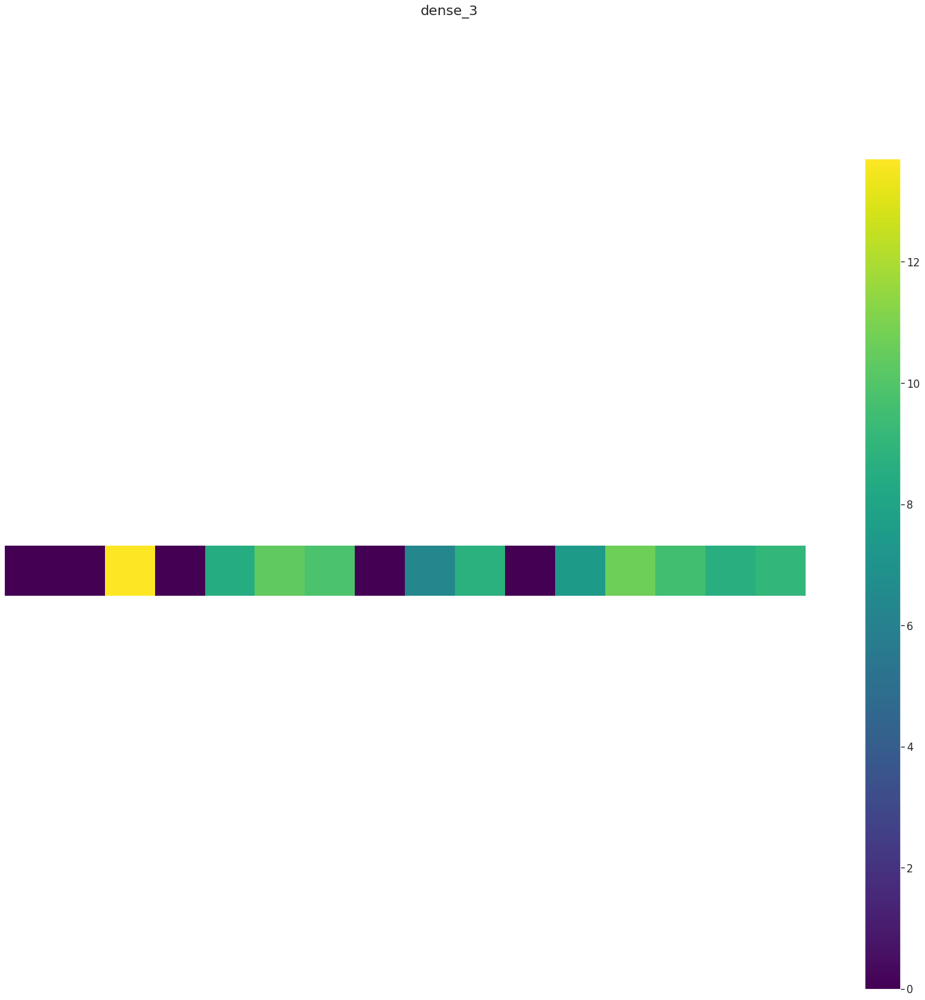

dropout_3 (1, 16) 


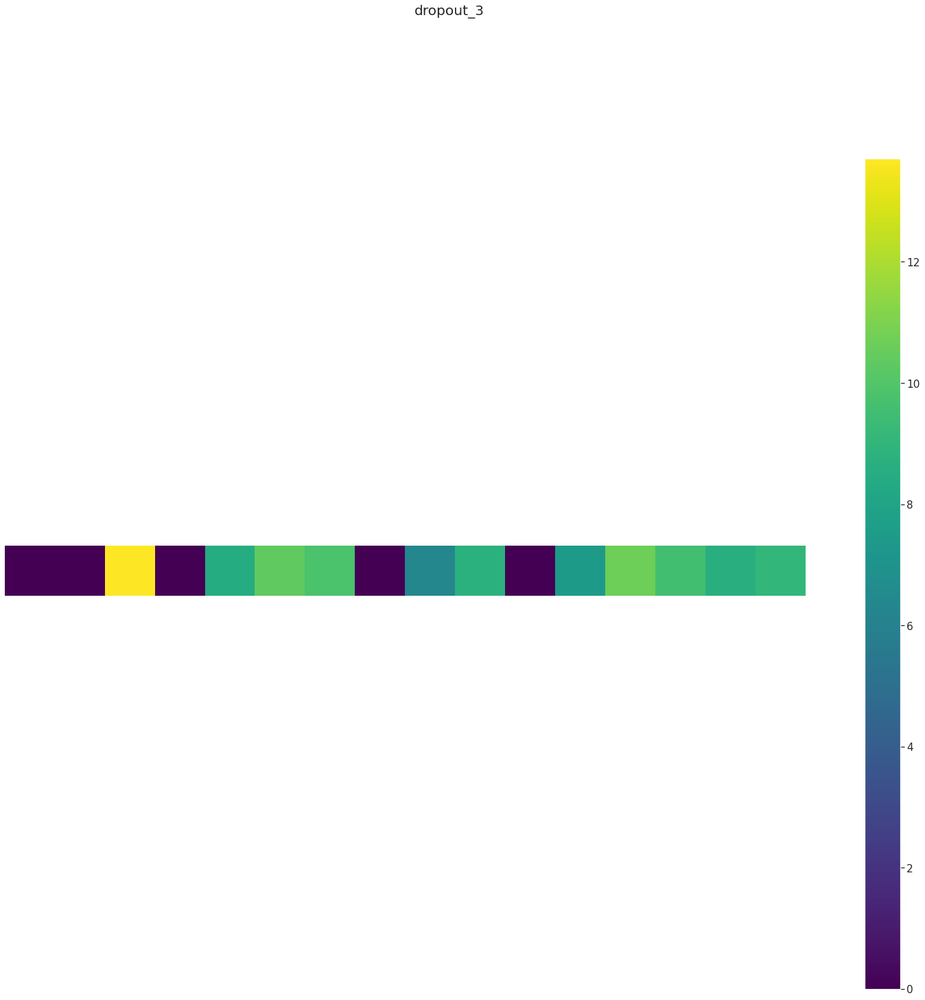

dense_4 (1, 2) 


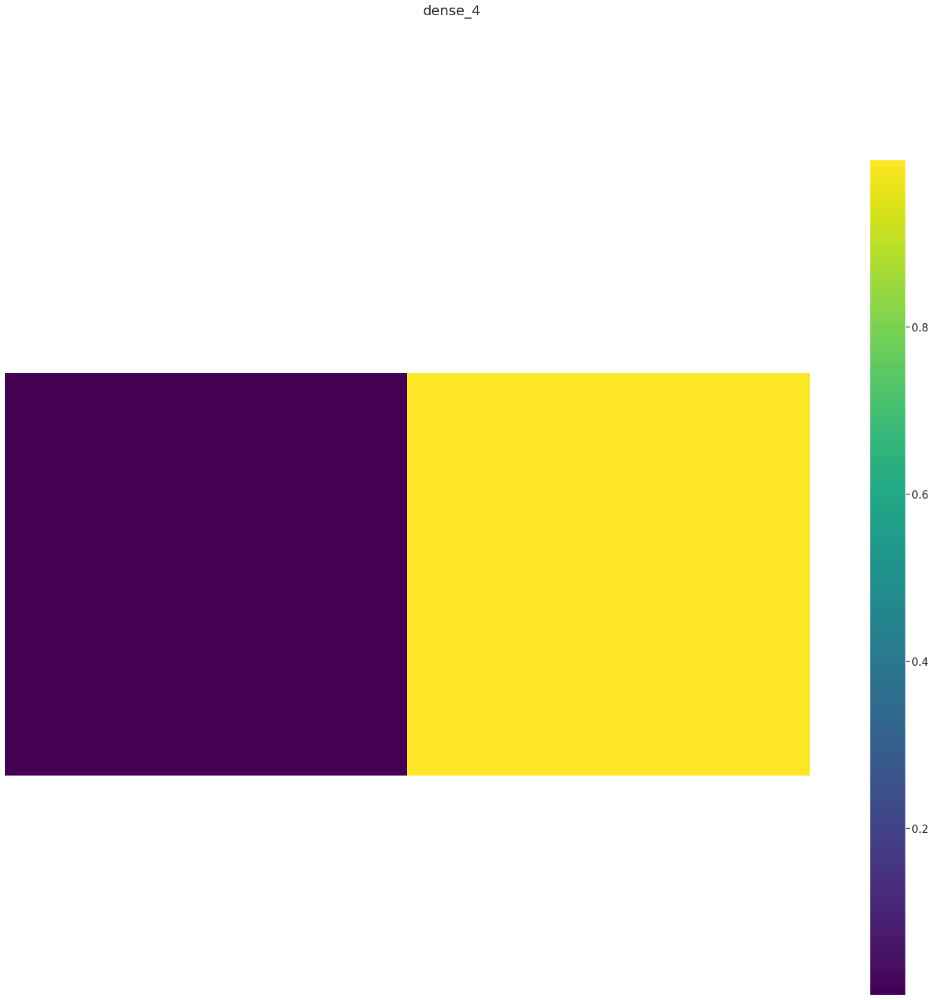

In [34]:
activations= keract.get_activations(model, image, layer_names= None, nodes_to_evaluate= None, output_format= 'simple', auto_compile= True)
keract.display_activations(activations, save= False, directory= './activations', cmap='viridis')

In [35]:
keract.display_activations(activations, save= True, directory= './activations', cmap='viridis')

input_1 (1, 224, 224, 3) 
block1_conv1 (1, 224, 224, 64) 
block1_conv2 (1, 224, 224, 64) 
block1_pool (1, 112, 112, 64) 
block2_conv1 (1, 112, 112, 128) 
block2_conv2 (1, 112, 112, 128) 
block2_pool (1, 56, 56, 128) 
block3_conv1 (1, 56, 56, 256) 
block3_conv2 (1, 56, 56, 256) 
block3_conv3 (1, 56, 56, 256) 
block3_pool (1, 28, 28, 256) 
block4_conv1 (1, 28, 28, 512) 
block4_conv2 (1, 28, 28, 512) 
block4_conv3 (1, 28, 28, 512) 
block4_pool (1, 14, 14, 512) 
block5_conv1 (1, 14, 14, 512) 
block5_conv2 (1, 14, 14, 512) 
block5_conv3 (1, 14, 14, 512) 
block5_pool (1, 7, 7, 512) 
global_average_pooling2d (1, 512) 
dense (1, 128) 
dropout (1, 128) 
dense_1 (1, 64) 
dropout_1 (1, 64) 
dense_2 (1, 32) 
dropout_2 (1, 32) 
dense_3 (1, 16) 
dropout_3 (1, 16) 
dense_4 (1, 2) 


# Saving all files from Kaggle Kernel

In [36]:
!zip -r kaggle_kernel_project_files.zip './'

  adding: activations/ (stored 0%)
  adding: activations/7_block3_conv1.png (deflated 0%)
  adding: activations/28_dense_4.png (deflated 59%)
  adding: activations/3_block1_pool.png (deflated 0%)
  adding: activations/4_block2_conv1.png (deflated 0%)
  adding: activations/8_block3_conv2.png (deflated 0%)
  adding: activations/6_block2_pool.png (deflated 0%)
  adding: activations/24_dense_2.png (deflated 50%)
  adding: activations/25_dropout_2.png (deflated 50%)
  adding: activations/26_dense_3.png (deflated 56%)
  adding: activations/1_block1_conv1.png (deflated 0%)
  adding: activations/2_block1_conv2.png (deflated 0%)
  adding: activations/19_global_average_pooling2d.png (deflated 46%)
  adding: activations/23_dropout_1.png (deflated 49%)
  adding: activations/14_block4_pool.png (deflated 6%)
  adding: activations/15_block5_conv1.png (deflated 6%)
  adding: activations/27_dropout_3.png (deflated 56%)
  adding: activations/17_block5_conv3.png (deflated 13%)
  adding: activations/18_bl